# Face recognition - Entrance door - Eval video analysis

- Analysis of all faces extracted from video (door-eval-video-charles-loreto-david-marcos-miguel-alvaro-andres.avi). 
- All faces are extracted processing all video frames
- Resolution: 1640 x 1232
- Picamera V2

## Initialization

In [2]:
import warnings
import time
import os
import datetime
warnings.filterwarnings('ignore')
import pickle
from helper_functions import show_distances_distributions, get_performance_v2, error_analysis, draw_error_analysis
import numpy as np
import face_recognition
import matplotlib.pyplot as plt
import cv2
import matplotlib.image as imreader
import random

%matplotlib inline

## Loading training data

In [3]:
face_db_path = "/home/asoriano/Escritorio/spaceai-evolution/evolution-vision/spaceai_vision_framework_project/resources/faces-dbs/sp2-v1/spaceai-evolution-train-v3-mix_faces_dataset.db"
with open(face_db_path, 'rb') as fp:
    face_db = pickle.load(fp)
train_face_names = face_db['names']
train_face_embeddings = face_db['embedding']
train_img_paths = face_db['images_path']
train_img_sizes = face_db['sizes']

In [8]:
type(train_face_embeddings[0])

numpy.ndarray

In [10]:
train_face_embeddings[0].shape

(128,)

In [3]:
# · Getting number of samples and faces
n_samples = len(train_face_names)
n_faces = len(set(train_face_names))

print("- Number of samples: " + str(n_samples))
print("- Number of faces: " + str(n_faces))
print(set(train_face_names))

- Number of samples: 18312
- Number of faces: 25
{'Diego De Las Heras', 'Miguel Alonso', 'Alan Turing', 'David Robert', 'Andres Doncel', 'Ramon Royo', 'Roman', 'Oscar Duarte', 'Loreto', 'Charles', 'Pablo Villacorta', 'Alvaro Jimenez', 'Manuel', 'Alvaro Gala', 'Miguel Hidalgo', 'Hugo Dominguez', 'Antonio Soriano', 'Antonio Guzman', 'Marcos Gonzalo', 'Guille Rios', 'Marcello', 'Joel Pocostales', 'Enrique', 'Marco', 'Fernando Velasco'}


#### Fixing image paths

In [4]:
train_img_paths[0]

'/mnt/hdd1tb/evolution-vision/face-recognition/resources/train_dir/spaceai-stratians/mix_faces_dataset/Alvaro Jimenez/2018-10-22-11:41:21-1102_1.jpg'

In [5]:
tais_path_prefix  = "/mnt/hdd1tb/evolution-vision/face-recognition/resources/train_dir/spaceai-stratians"
local_path_prefix = "/home/asoriano/Escritorio/Facial-sp2-v1"
def local_path(path):
    return path.replace(tais_path_prefix, local_path_prefix)

In [6]:
train_img_paths = [local_path(p) for p in train_img_paths]

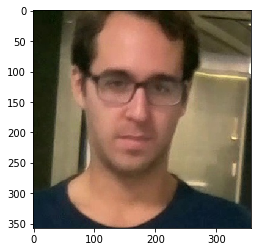

In [7]:
plt.imshow(plt.imread(train_img_paths[0]))
plt.show()

#### Distances distribution

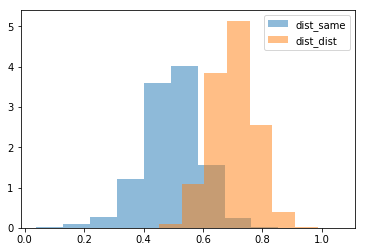

In [9]:
show_distances_distributions(train_face_names, train_face_embeddings)

## Loading eval data

In [3]:
face_db_path = "/home/asoriano/Stratio/spaceAI/evolution-vision/src/resources/faces-dbs/sp2-v1/door-entry-eval-1.db"
with open(face_db_path, 'rb') as fp:
    face_db = pickle.load(fp)
eval_face_names = face_db['names']
eval_face_embeddings = face_db['embedding']
eval_img_paths = face_db['images_path']
eval_img_sizes = face_db['sizes']

In [4]:
# Fixing name
eval_face_names = ["Andres Doncel" if n =="Andres Doncell" else n for n in eval_face_names]

In [5]:
# · Getting number of samples and faces
n_samples = len(eval_face_names)
n_faces = len(set(eval_face_names))
print("- Number of samples: " + str(n_samples))
print("- Number of faces: " + str(n_faces))
print(set(eval_face_names))

- Number of samples: 741
- Number of faces: 9
{'Loreto', 'Alvaro Jimenez', 'Andres Doncel', 'Marcos Gonzalo', 'Antonio Guzman', 'Miguel Alonso', 'David Robert', 'Charles', 'Unknown'}


#### Distances distribution

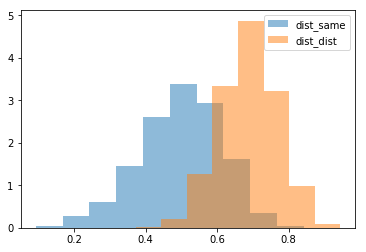

In [12]:
show_distances_distributions(eval_face_names, eval_face_embeddings)

#### Getting unknown people in evaluation video

In [13]:
unknown_people = list(set(eval_face_names) - set(train_face_names))
print("Unknown people: " + str(unknown_people))

eval_face_names_unk = ["unknown" if n in unknown_people else n for n in eval_face_names]
print( "Final set of faces/labels in evaluation: " + str(set(eval_face_names_unk)))

Unknown people: ['Unknown']
Final set of faces/labels in evaluation: {'Loreto', 'Miguel Alonso', 'unknown', 'Charles', 'Alvaro Jimenez', 'Antonio Guzman', 'David Robert', 'Andres Doncel', 'Marcos Gonzalo'}


## Performance analysis

#### Min. distance search (KNN k=1)

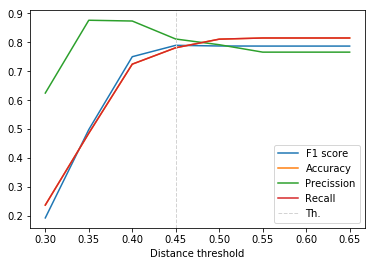

Optimal threshold: 0.45
F1-Score: [0.19315007420915684, 0.49843532651413214, 0.75041009443280571, 0.78976690119220061, 0.78749034163306242, 0.78716726983207197, 0.78716726983207197, 0.78716726983207197]
Accuracy: [0.23751686909581646, 0.48582995951417002, 0.7246963562753036, 0.78137651821862353, 0.81106612685560053, 0.81511470985155199, 0.81511470985155199, 0.81511470985155199]
Precission: [0.62473134402958963, 0.87647006487351975, 0.87376636262988239, 0.81153500946308754, 0.79185440441802901, 0.76622321104615854, 0.76622321104615854, 0.76622321104615854]
Recall: [0.23751686909581646, 0.48582995951417002, 0.7246963562753036, 0.78137651821862353, 0.81106612685560053, 0.81511470985155199, 0.81511470985155199, 0.81511470985155199]


In [14]:
opt_tau_k1, f1_k1, accuracy_k1, precission_k1, recall_k1, labeled_name_k1, predicted_name_k1, knn_output_k1 = \
    get_performance_v2(1, np.arange(0.3, 0.7, 0.05), train_face_names, train_face_embeddings, eval_face_names_unk, eval_face_embeddings, "unknown")

print("Optimal threshold: " + str(opt_tau_k1))
print("F1-Score: " + str(f1_k1))
print("Accuracy: " + str(accuracy_k1))
print("Precission: " + str(precission_k1))
print("Recall: " + str(recall_k1))

In [17]:
analysis_k1 = error_analysis(labeled_name_k1, predicted_name_k1, knn_output_k1)

Total evaluation samples: 741
Total errors: 162
Correct recognized: 563
Correct unknown: 16
Error - unrecognized (someone --> unknown): 49
Error - missclasified (someone --> other): 19
Error - false positive (unknown --> someone): 94


-----------------------------------------------------------
 => Unrecognized errors
-----------------------------------------------------------


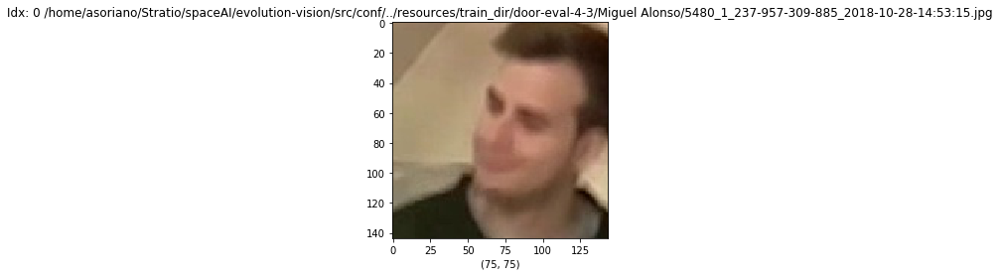

_________________________________________________________________________________________


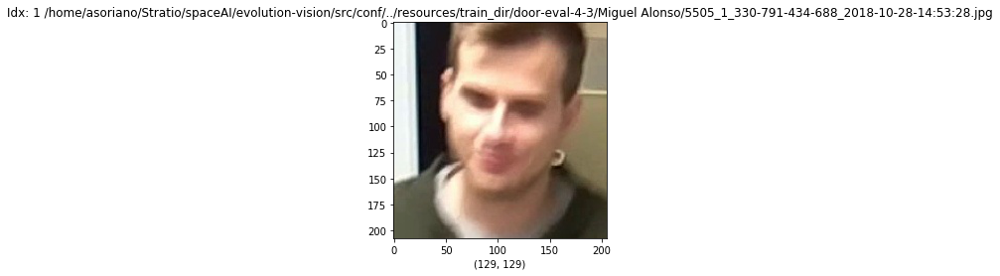

_________________________________________________________________________________________


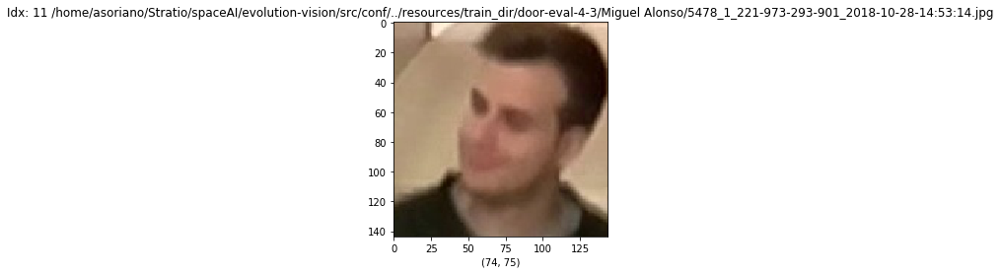

_________________________________________________________________________________________


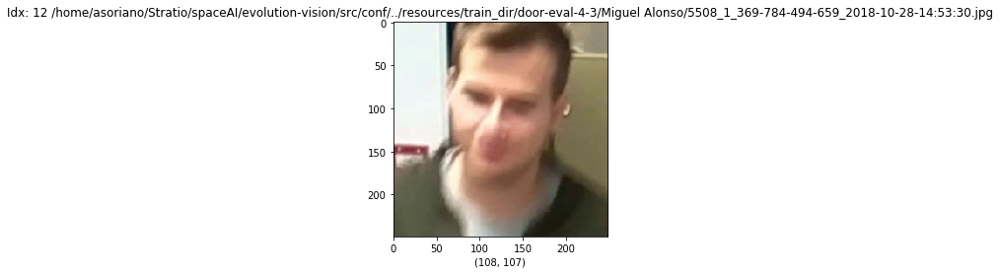

_________________________________________________________________________________________


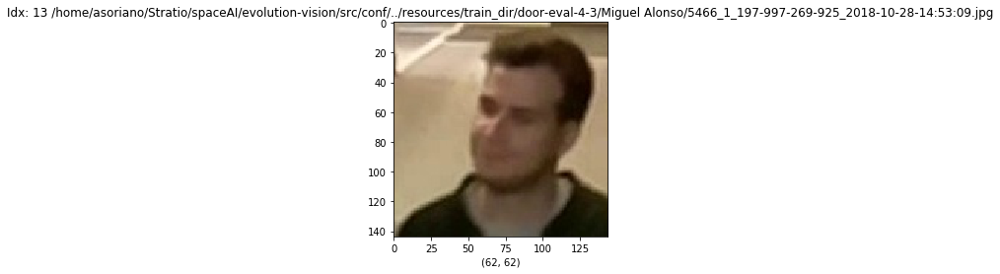

_________________________________________________________________________________________


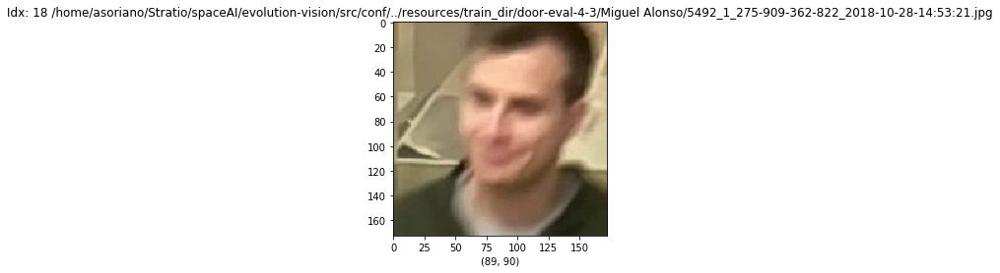

_________________________________________________________________________________________


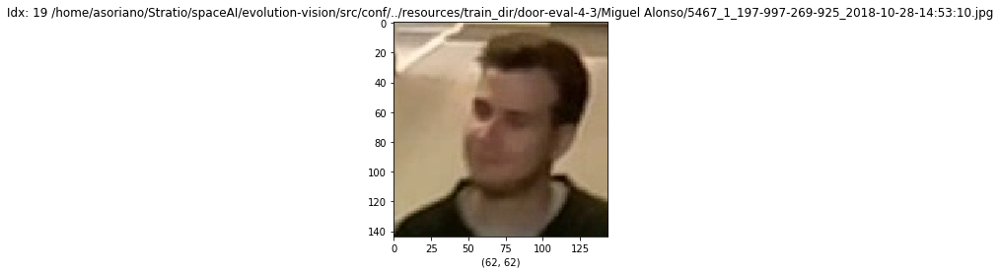

_________________________________________________________________________________________


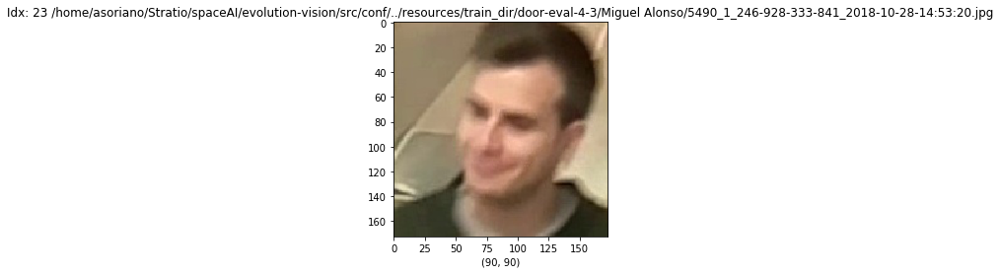

_________________________________________________________________________________________


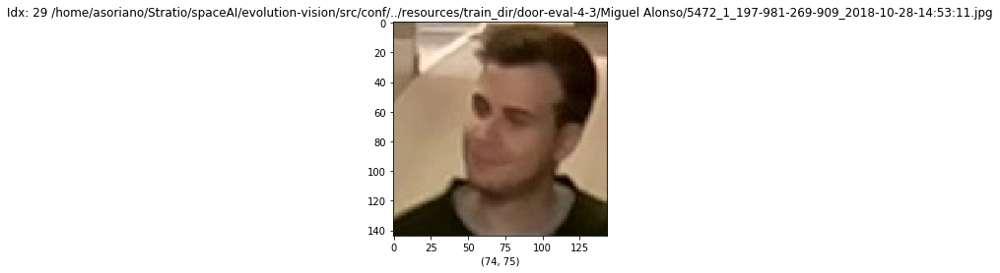

_________________________________________________________________________________________


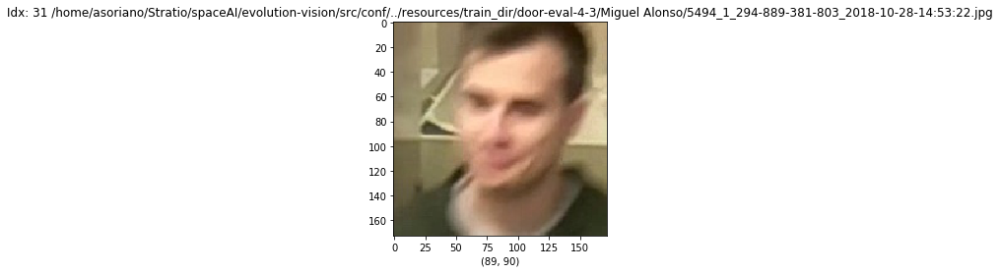

_________________________________________________________________________________________


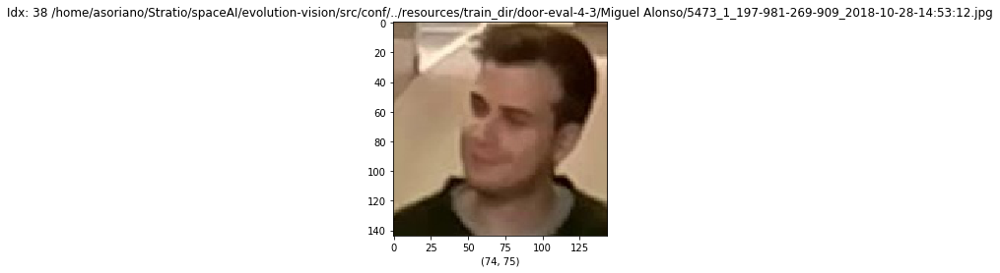

_________________________________________________________________________________________


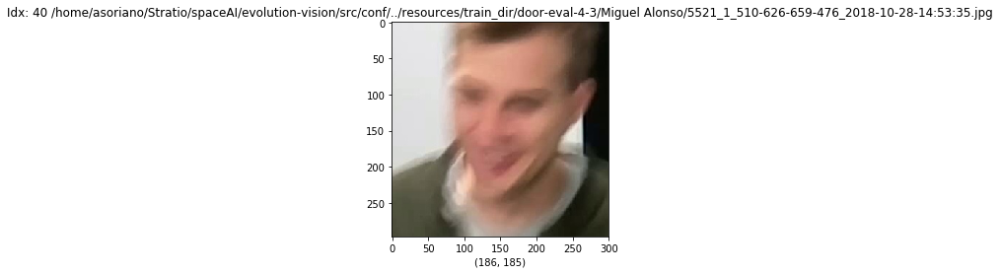

_________________________________________________________________________________________


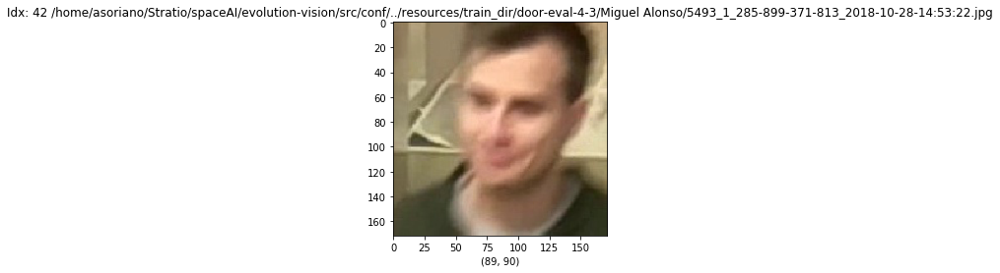

_________________________________________________________________________________________


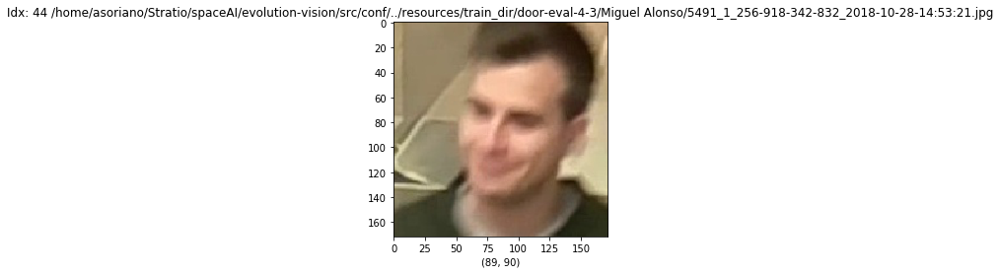

_________________________________________________________________________________________


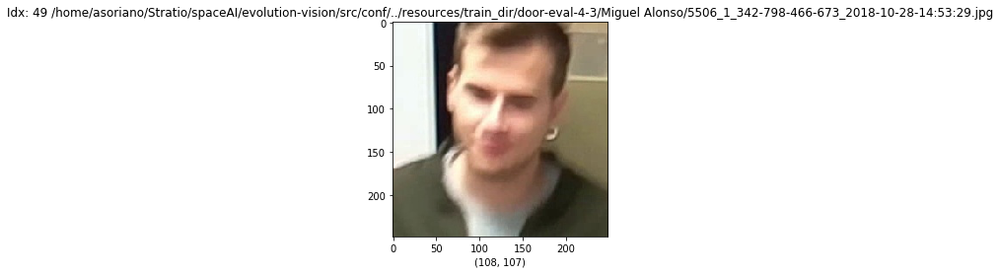

_________________________________________________________________________________________


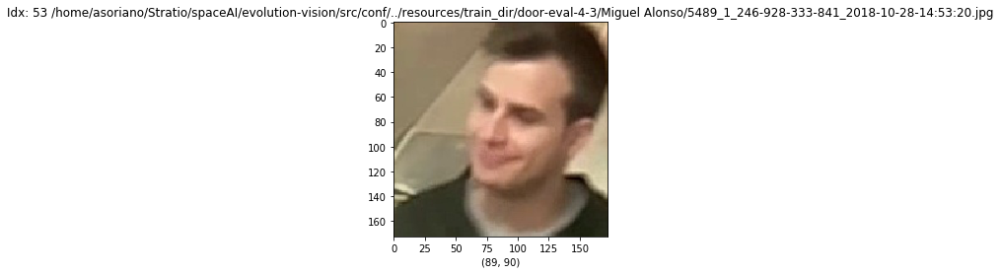

_________________________________________________________________________________________


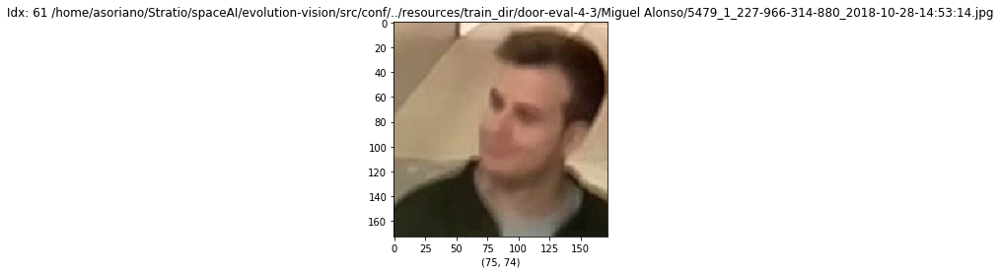

_________________________________________________________________________________________


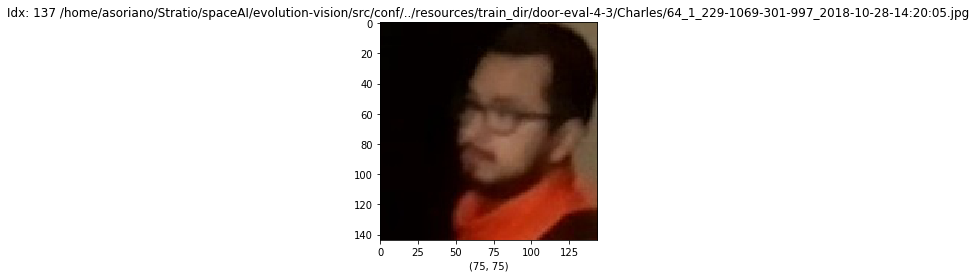

_________________________________________________________________________________________


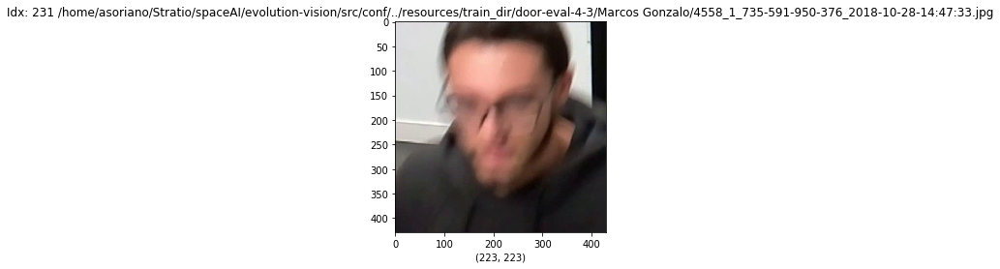

_________________________________________________________________________________________


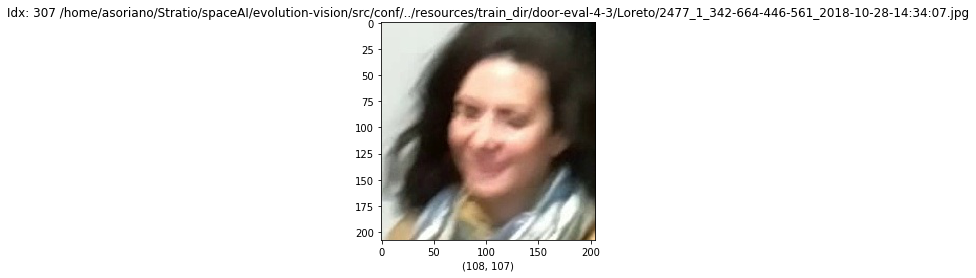

_________________________________________________________________________________________


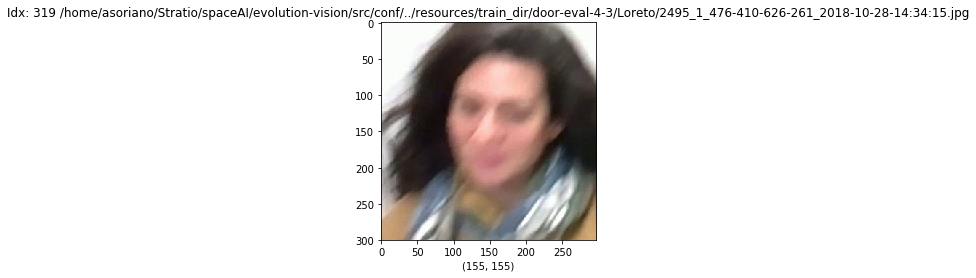

_________________________________________________________________________________________


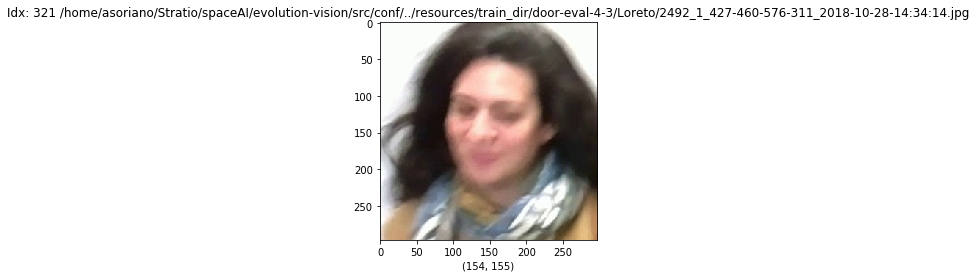

_________________________________________________________________________________________


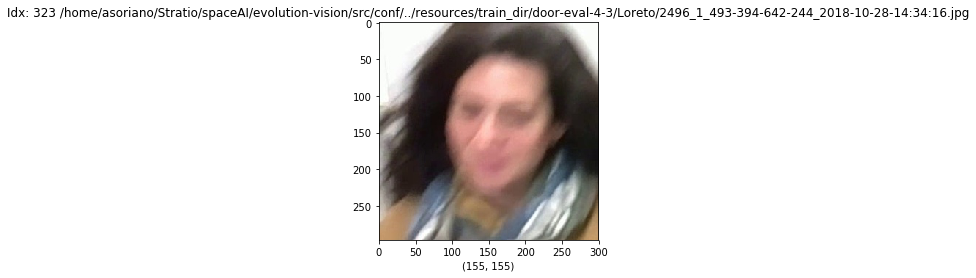

_________________________________________________________________________________________


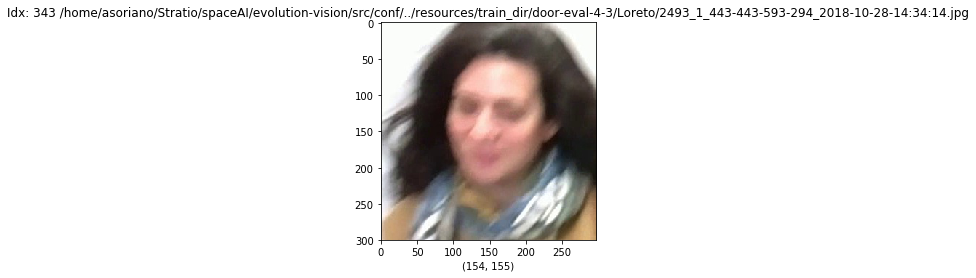

_________________________________________________________________________________________


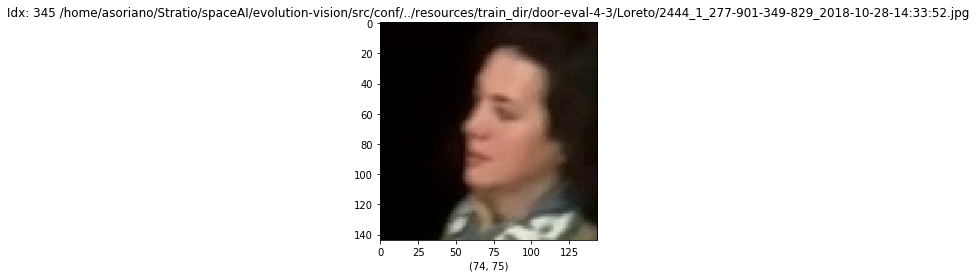

_________________________________________________________________________________________


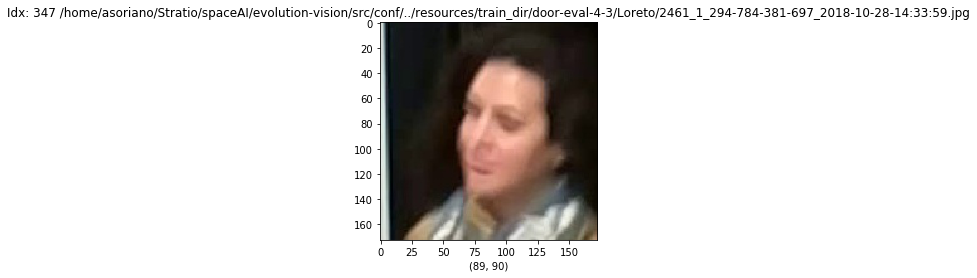

_________________________________________________________________________________________


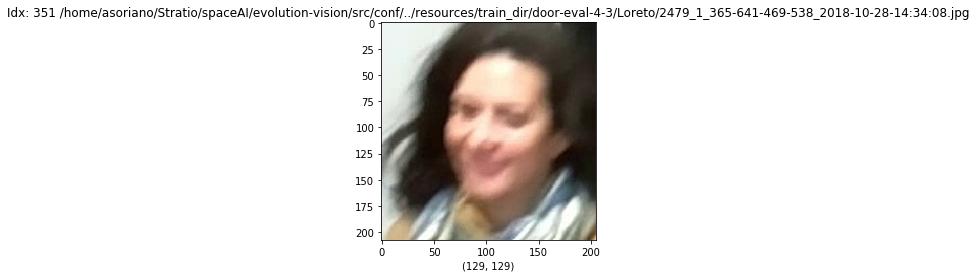

_________________________________________________________________________________________


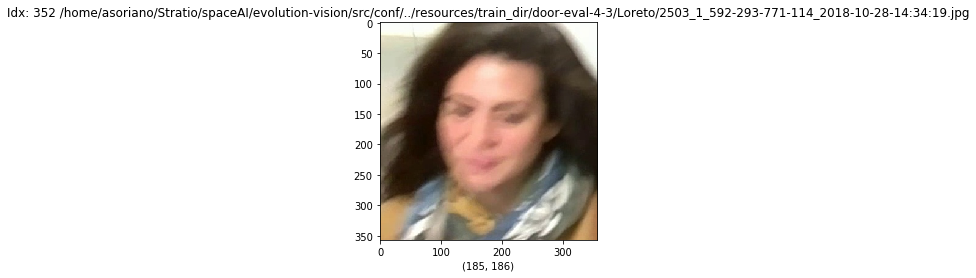

_________________________________________________________________________________________


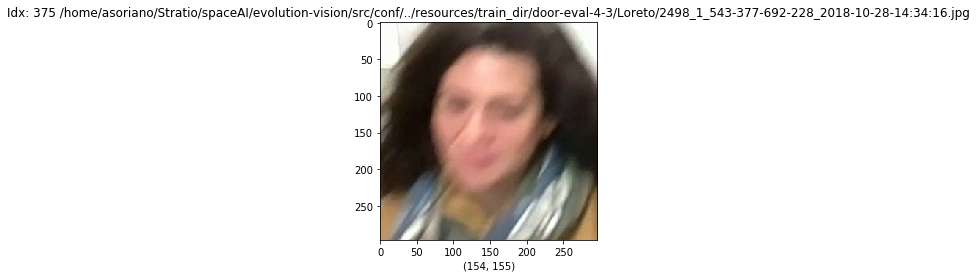

_________________________________________________________________________________________


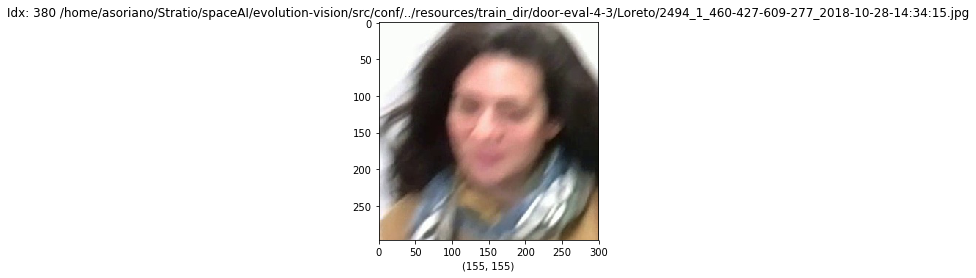

_________________________________________________________________________________________


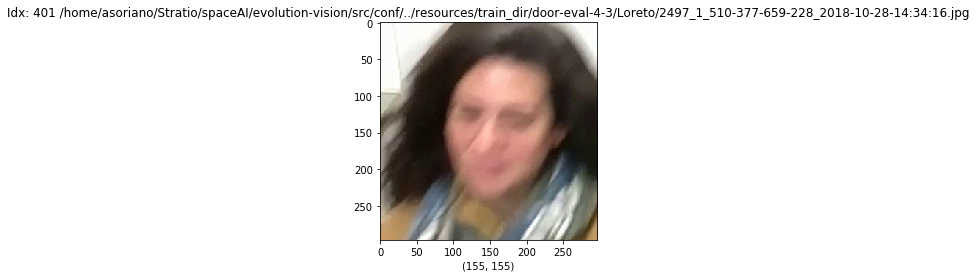

_________________________________________________________________________________________


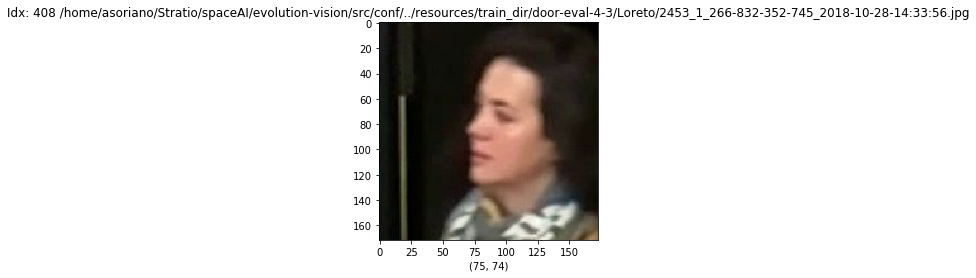

_________________________________________________________________________________________


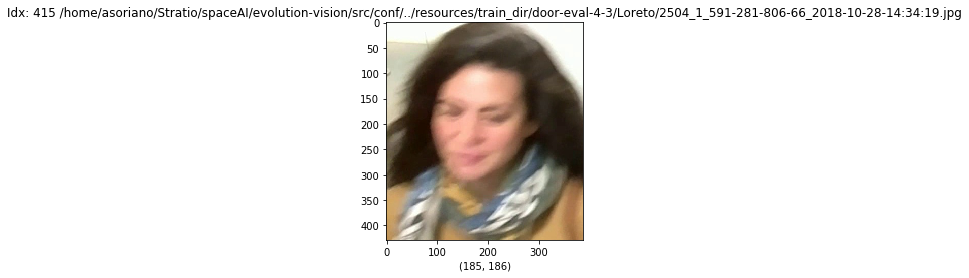

_________________________________________________________________________________________


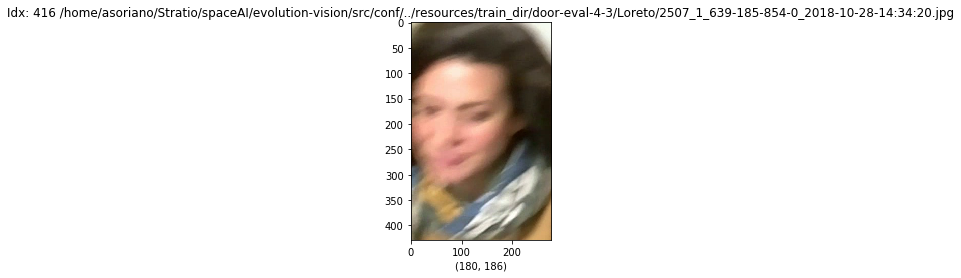

_________________________________________________________________________________________


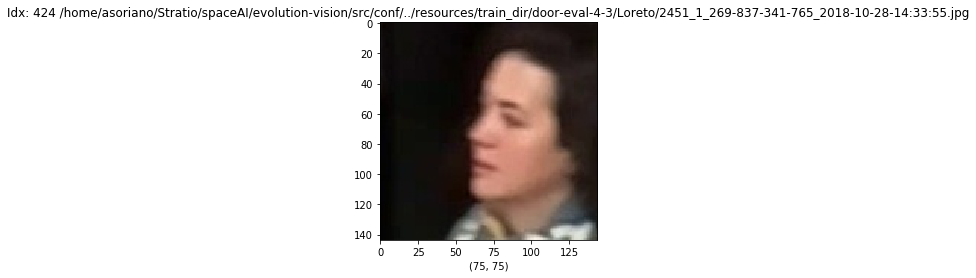

_________________________________________________________________________________________


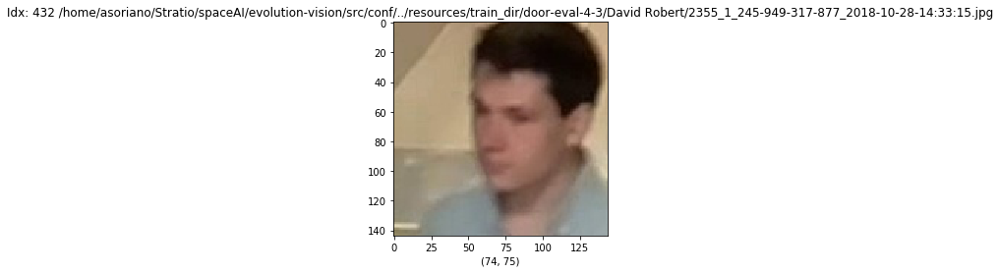

_________________________________________________________________________________________


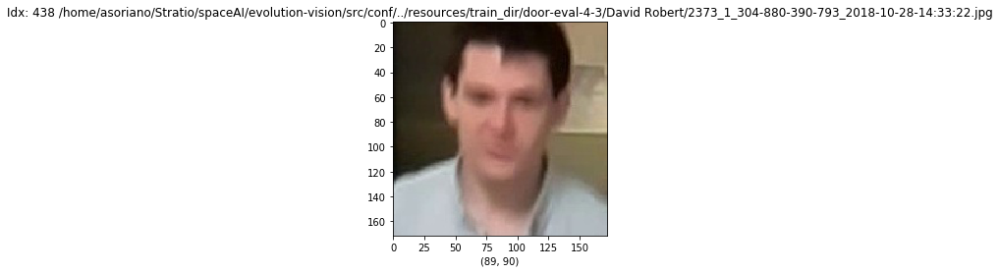

_________________________________________________________________________________________


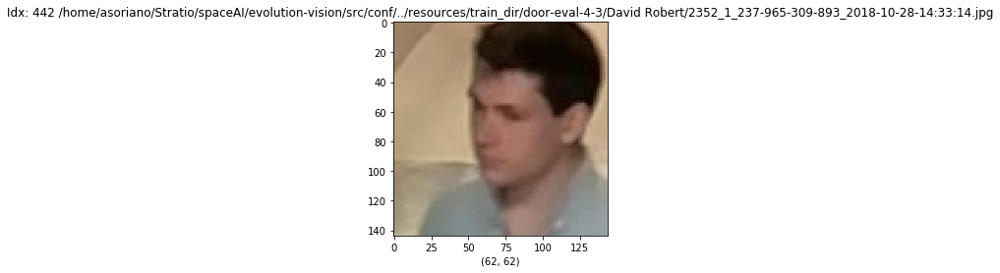

_________________________________________________________________________________________


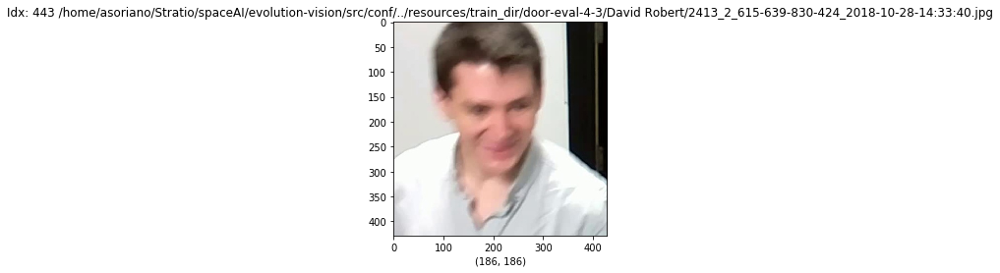

_________________________________________________________________________________________


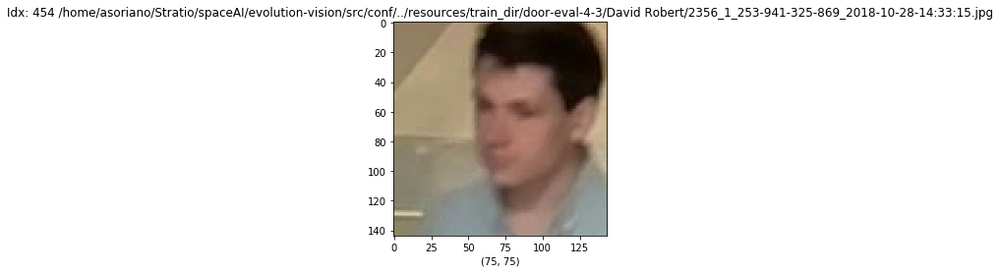

_________________________________________________________________________________________


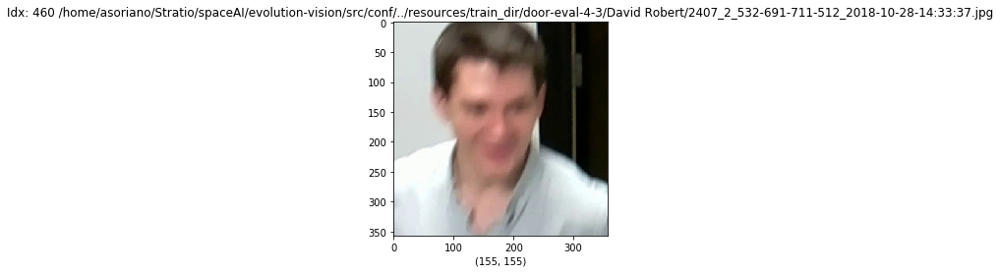

_________________________________________________________________________________________


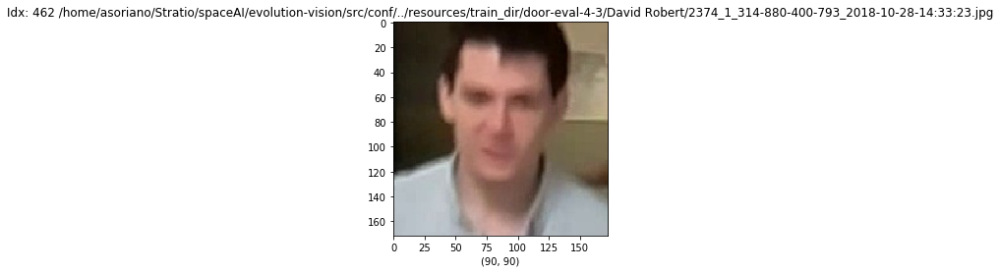

_________________________________________________________________________________________


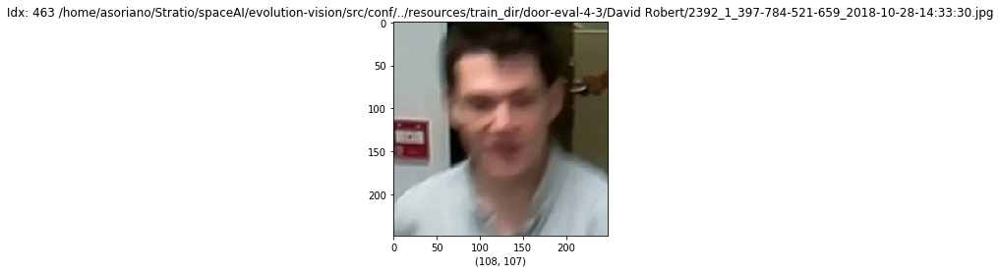

_________________________________________________________________________________________


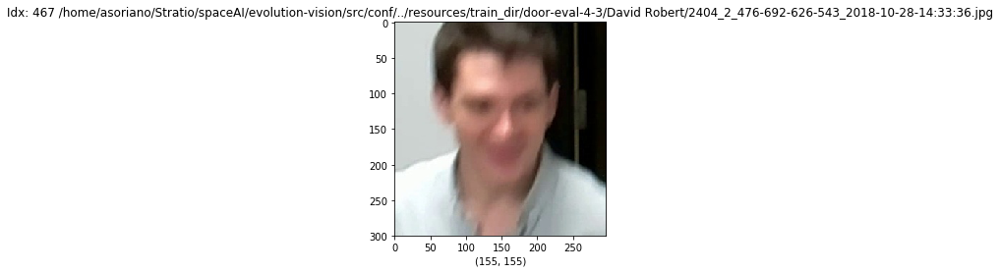

_________________________________________________________________________________________


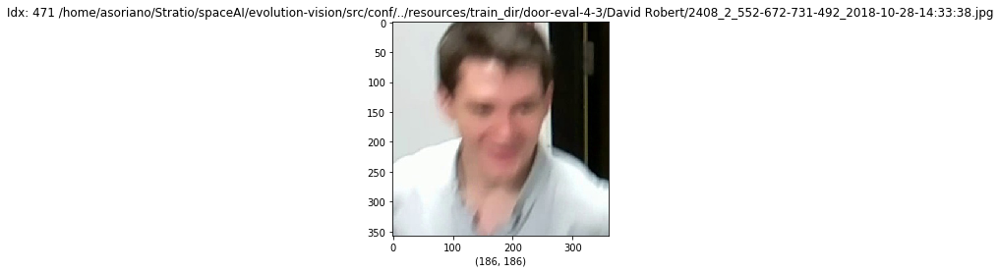

_________________________________________________________________________________________


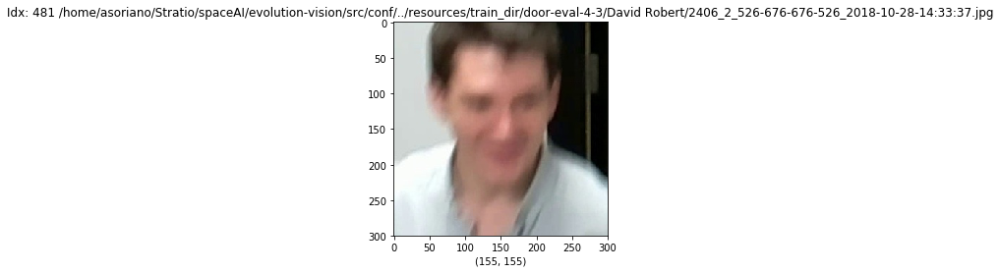

_________________________________________________________________________________________


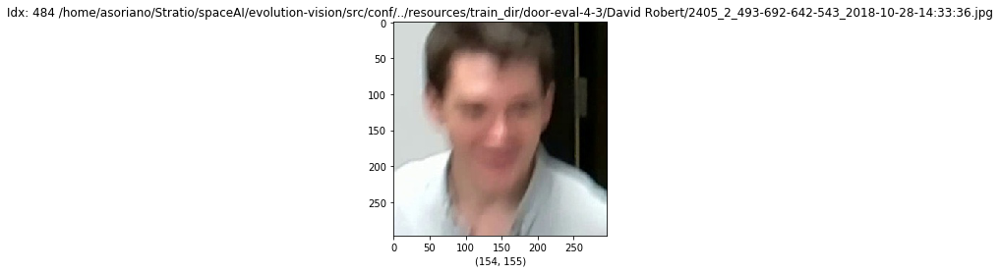

_________________________________________________________________________________________


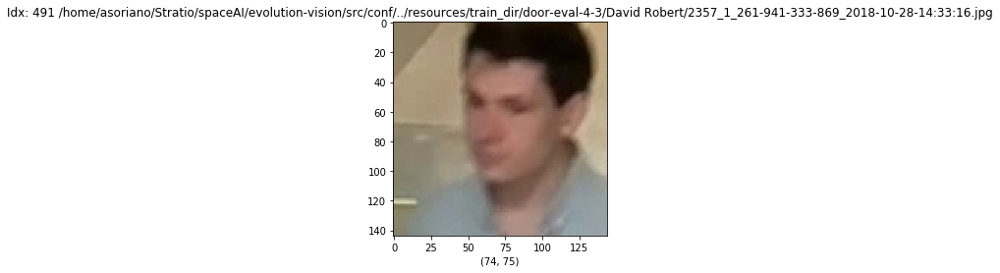

_________________________________________________________________________________________


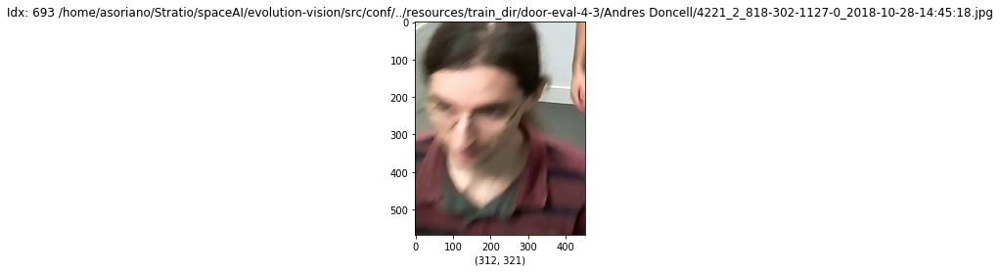

_________________________________________________________________________________________
-----------------------------------------------------------
 => Misclassified errors
-----------------------------------------------------------


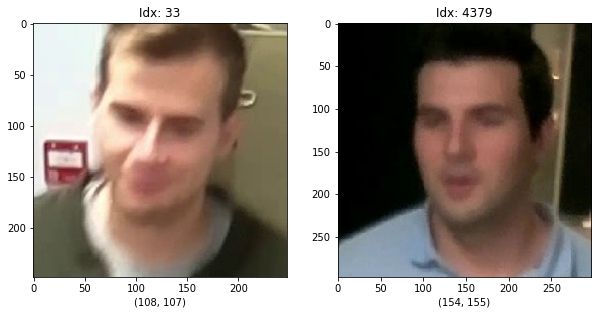

_________________________________________________________________________________________


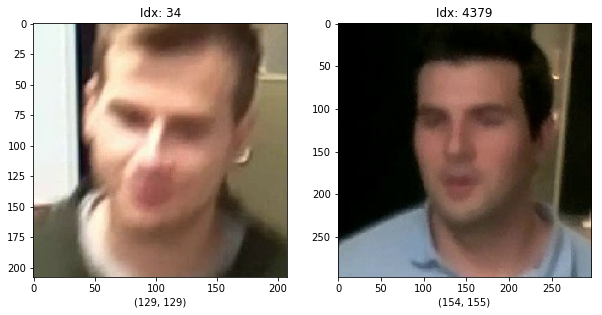

_________________________________________________________________________________________


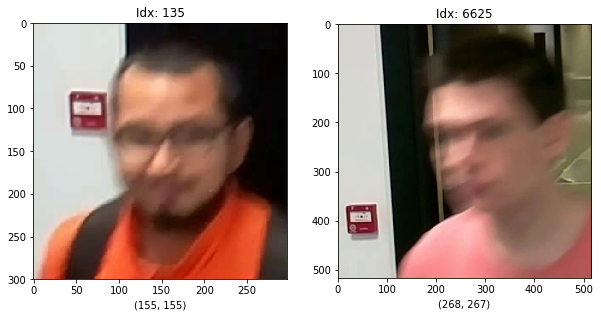

_________________________________________________________________________________________


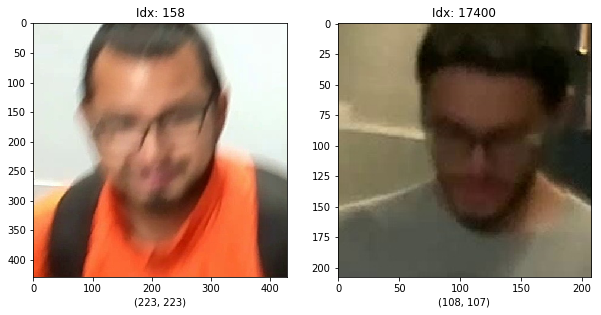

_________________________________________________________________________________________


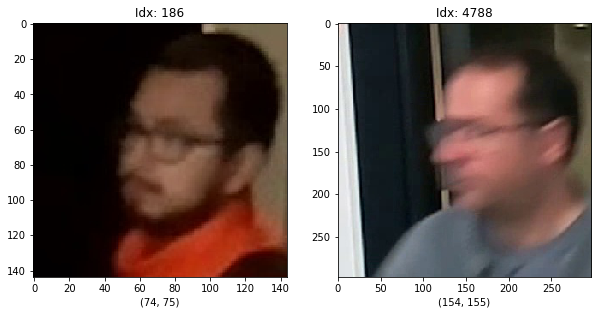

_________________________________________________________________________________________


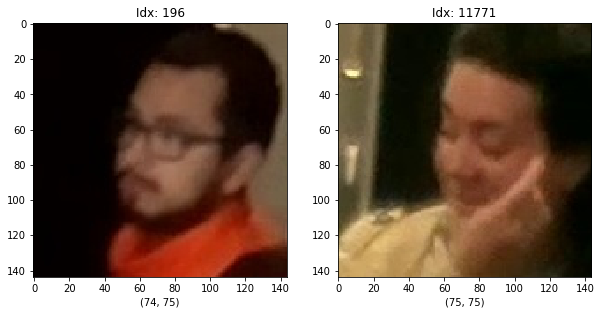

_________________________________________________________________________________________


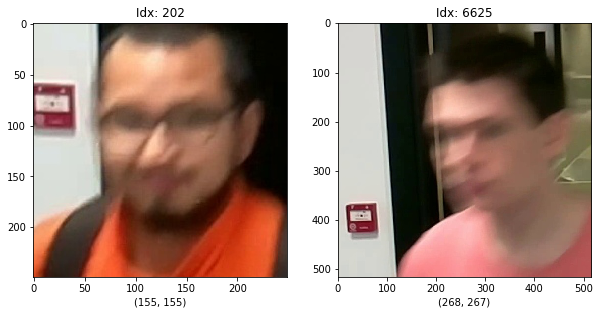

_________________________________________________________________________________________


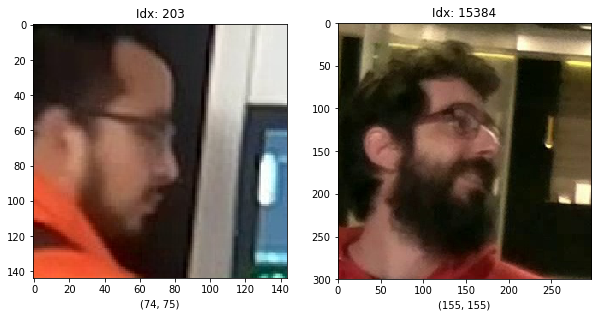

_________________________________________________________________________________________


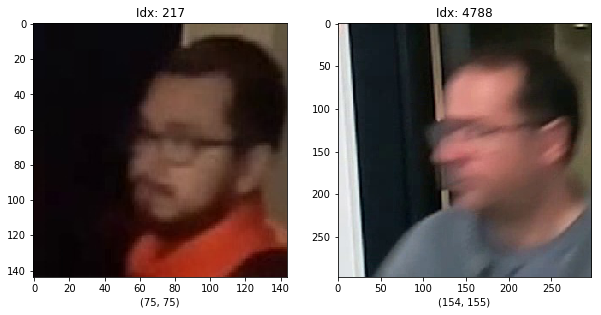

_________________________________________________________________________________________


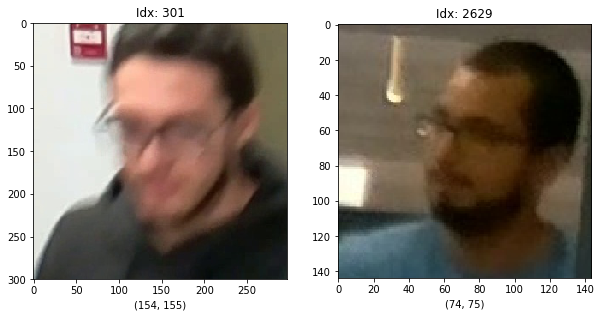

_________________________________________________________________________________________


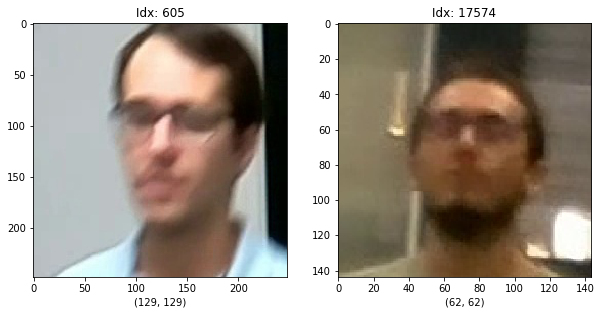

_________________________________________________________________________________________


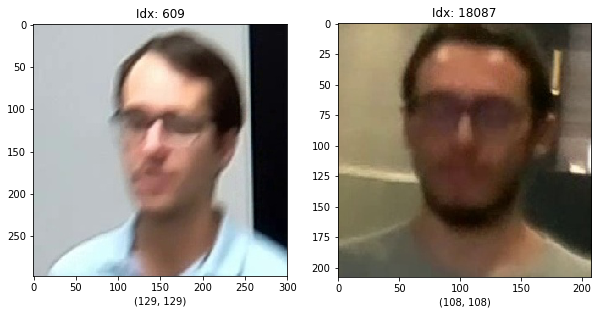

_________________________________________________________________________________________


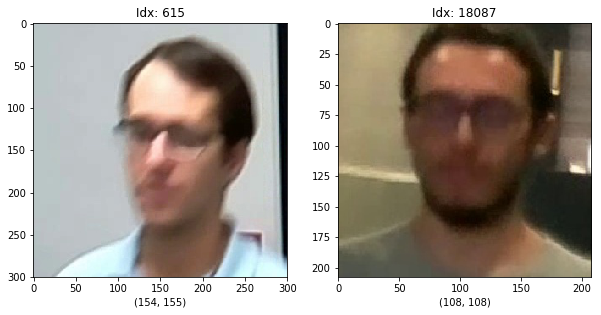

_________________________________________________________________________________________


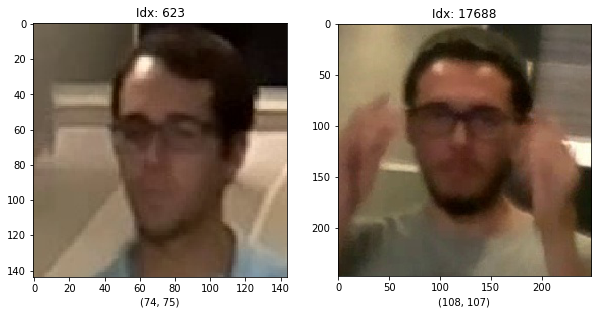

_________________________________________________________________________________________


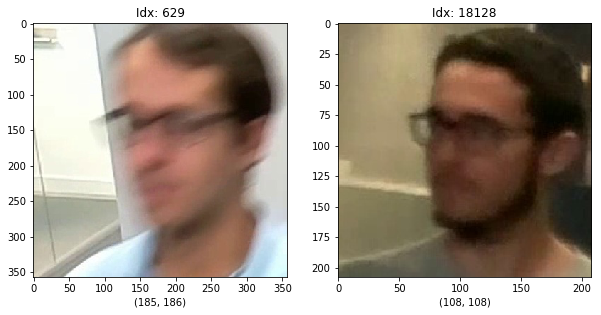

_________________________________________________________________________________________


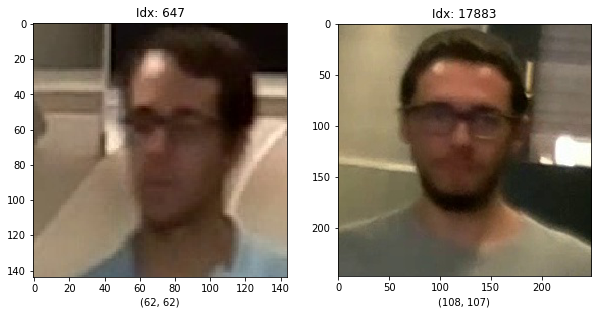

_________________________________________________________________________________________


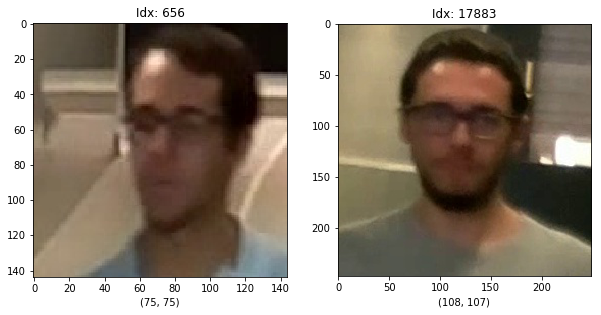

_________________________________________________________________________________________


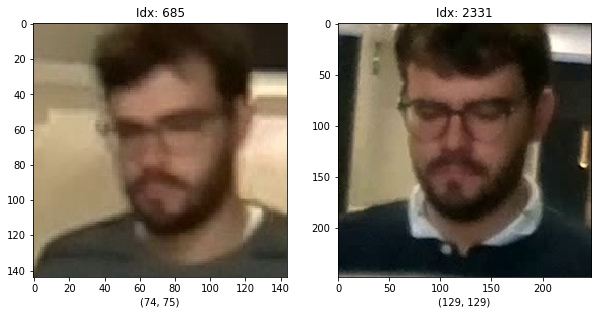

_________________________________________________________________________________________


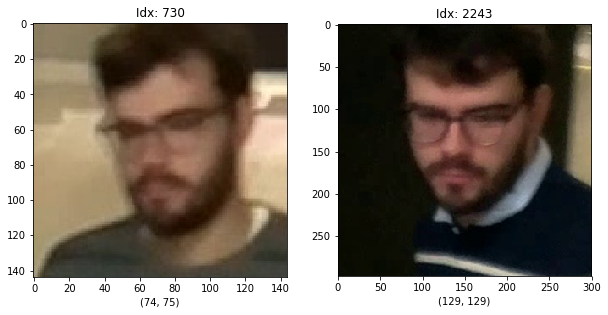

_________________________________________________________________________________________
-----------------------------------------------------------
 => False positive errors
-----------------------------------------------------------


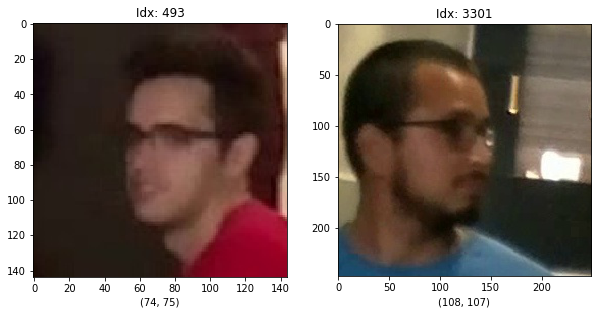

_________________________________________________________________________________________


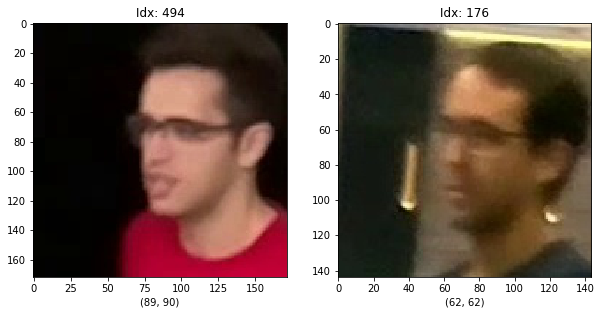

_________________________________________________________________________________________


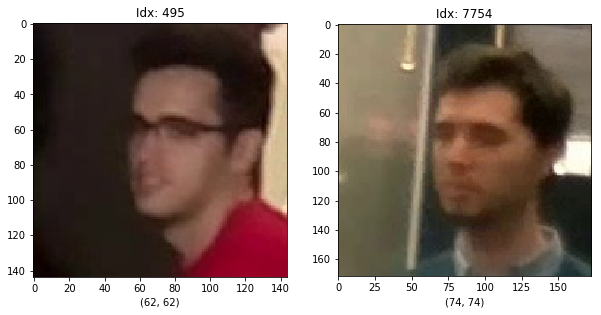

_________________________________________________________________________________________


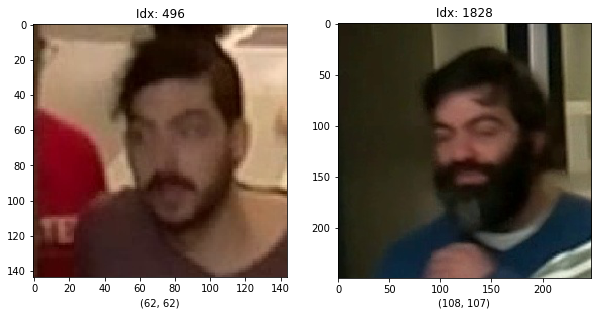

_________________________________________________________________________________________


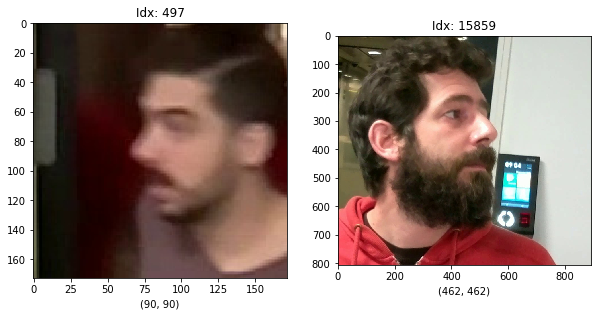

_________________________________________________________________________________________


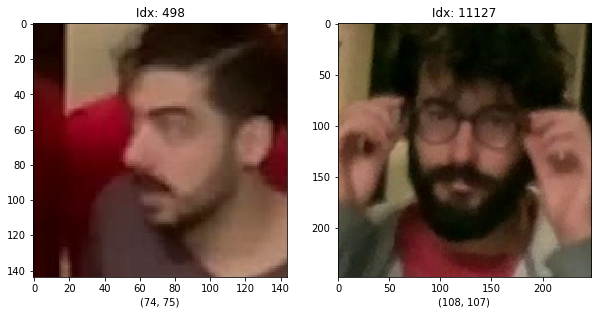

_________________________________________________________________________________________


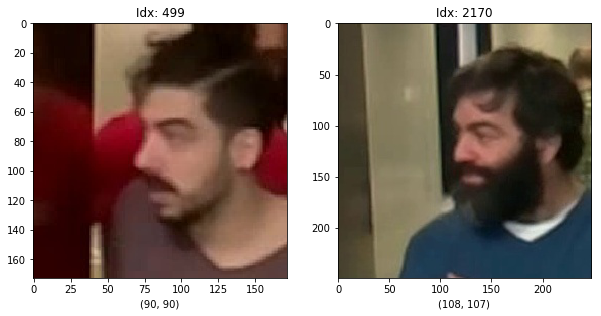

_________________________________________________________________________________________


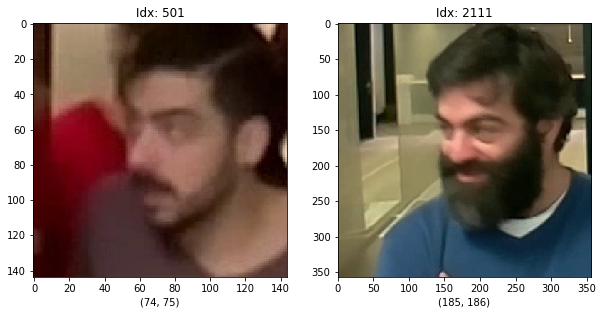

_________________________________________________________________________________________


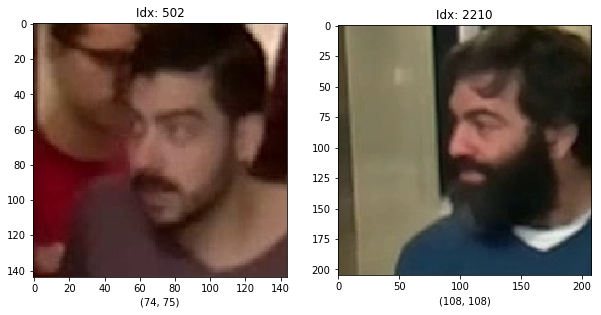

_________________________________________________________________________________________


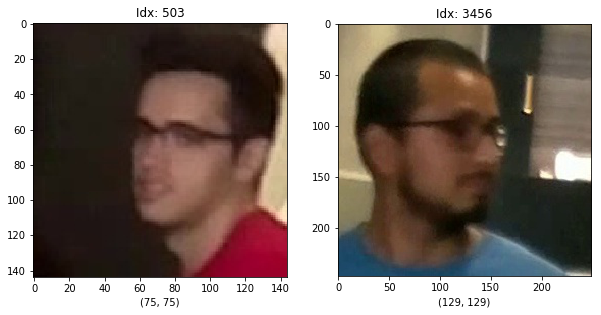

_________________________________________________________________________________________


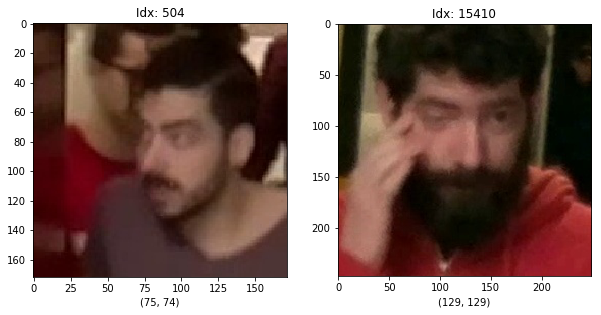

_________________________________________________________________________________________


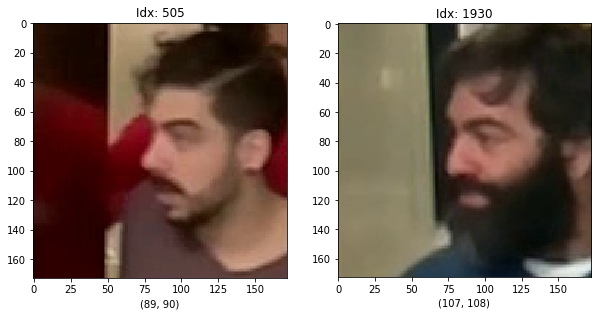

_________________________________________________________________________________________


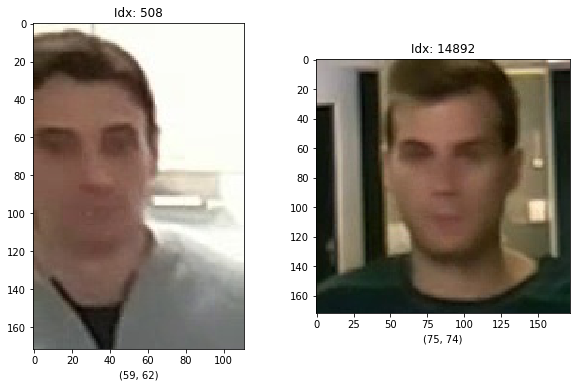

_________________________________________________________________________________________


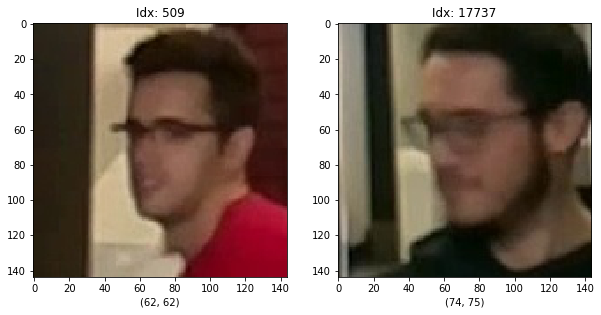

_________________________________________________________________________________________


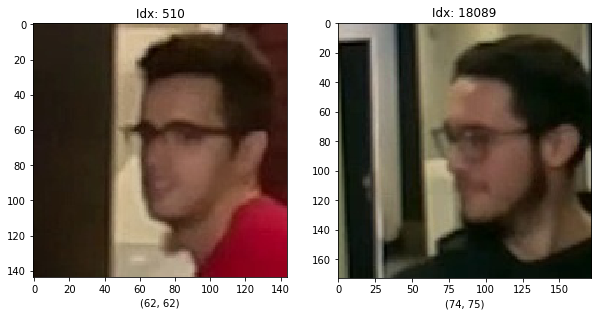

_________________________________________________________________________________________


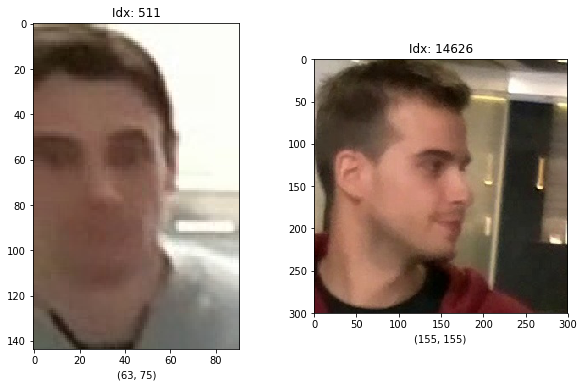

_________________________________________________________________________________________


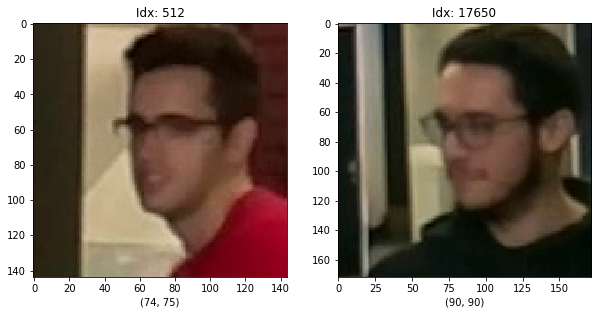

_________________________________________________________________________________________


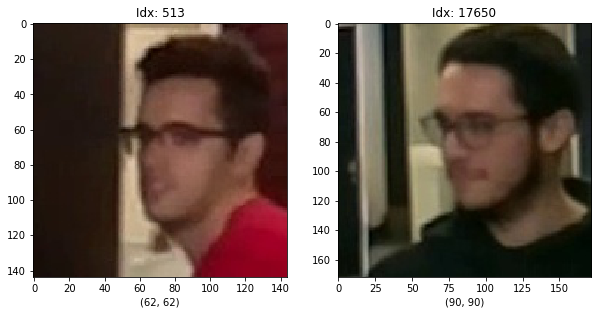

_________________________________________________________________________________________


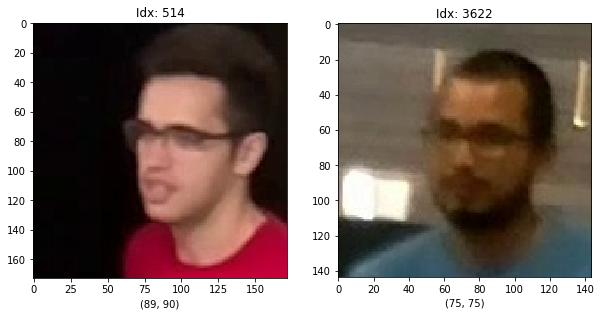

_________________________________________________________________________________________


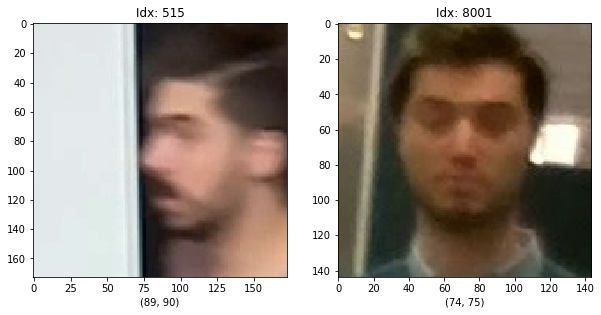

_________________________________________________________________________________________


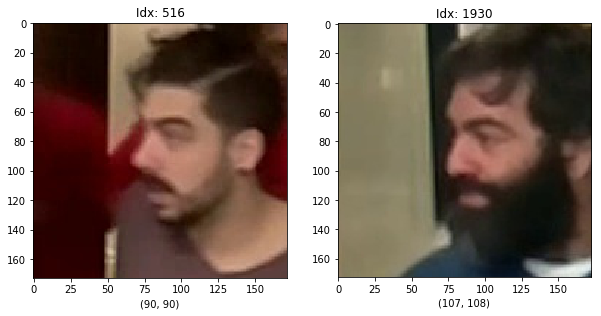

_________________________________________________________________________________________


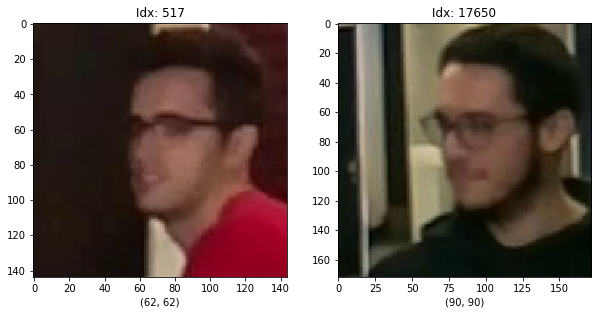

_________________________________________________________________________________________


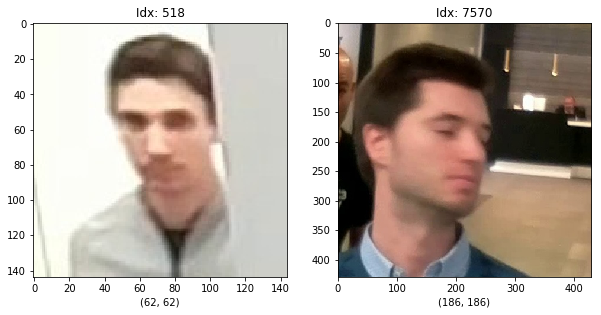

_________________________________________________________________________________________


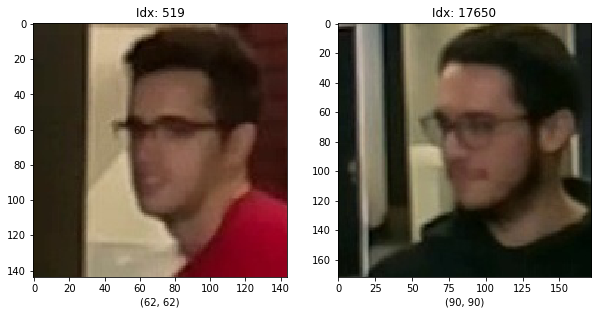

_________________________________________________________________________________________


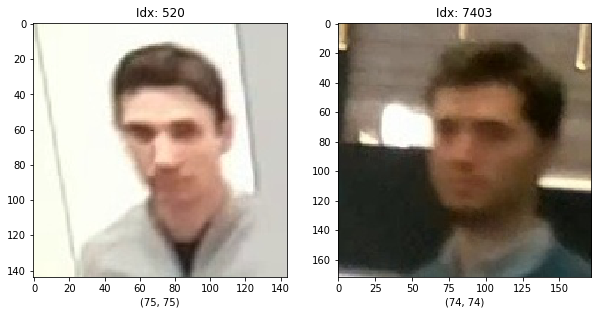

_________________________________________________________________________________________


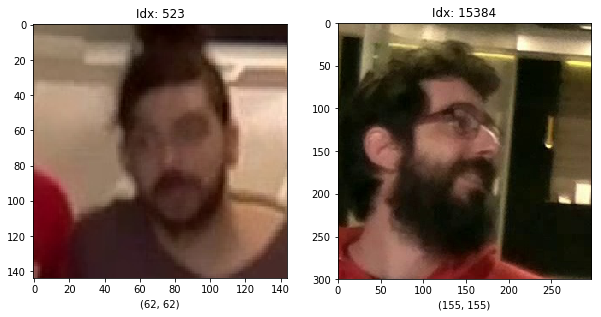

_________________________________________________________________________________________


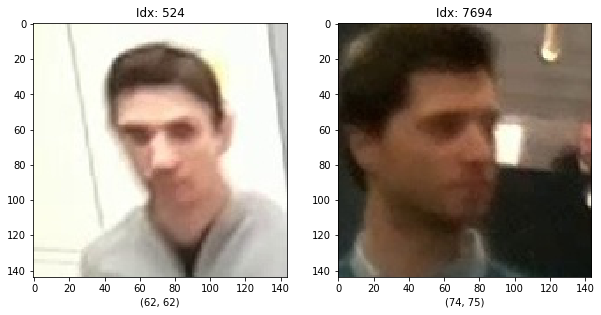

_________________________________________________________________________________________


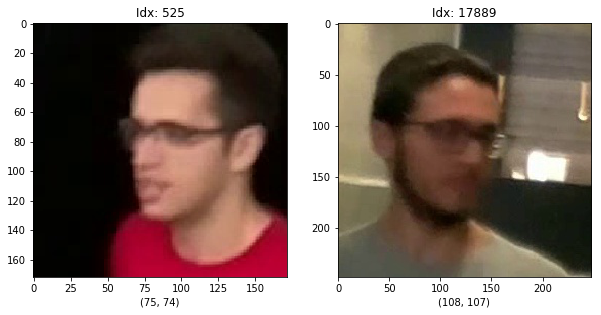

_________________________________________________________________________________________


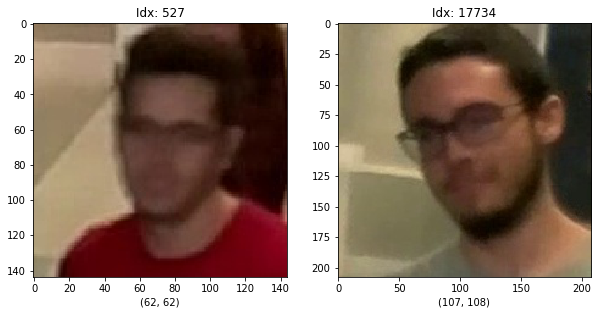

_________________________________________________________________________________________


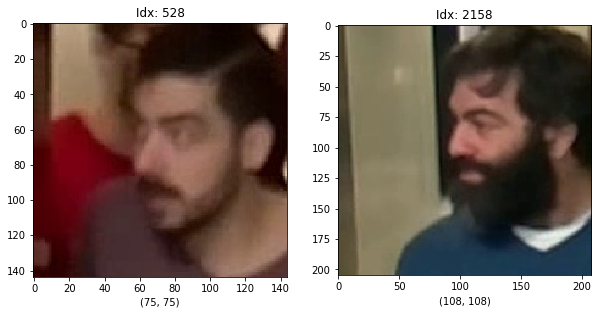

_________________________________________________________________________________________


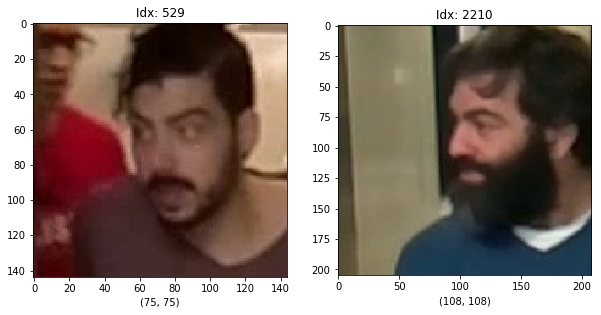

_________________________________________________________________________________________


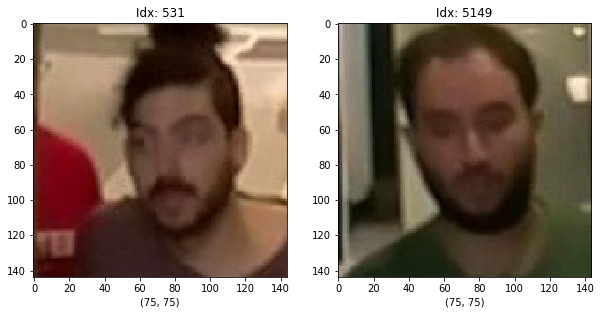

_________________________________________________________________________________________


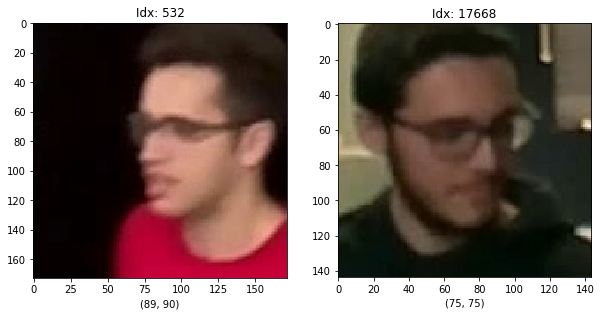

_________________________________________________________________________________________


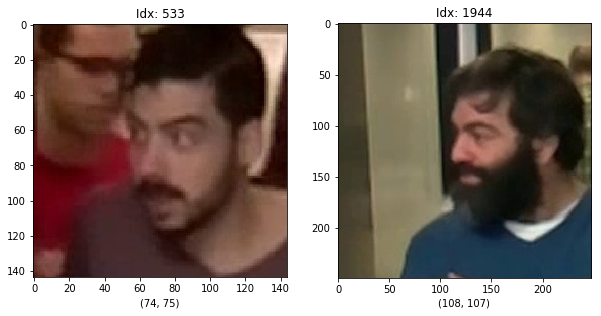

_________________________________________________________________________________________


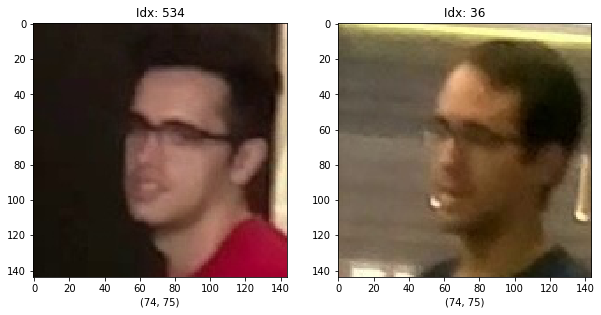

_________________________________________________________________________________________


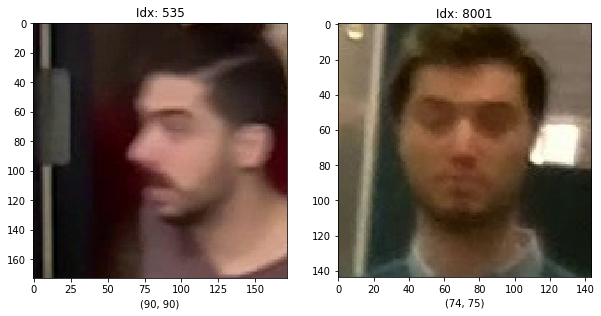

_________________________________________________________________________________________


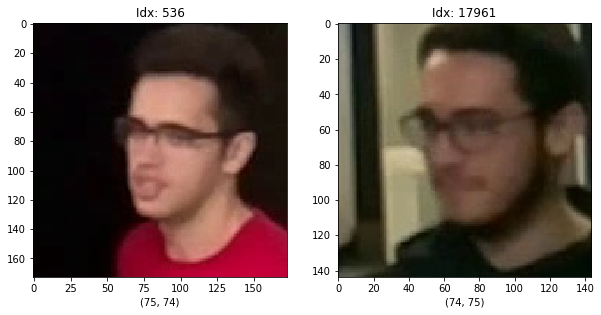

_________________________________________________________________________________________


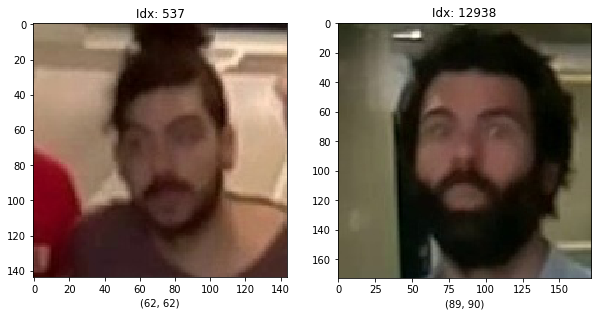

_________________________________________________________________________________________


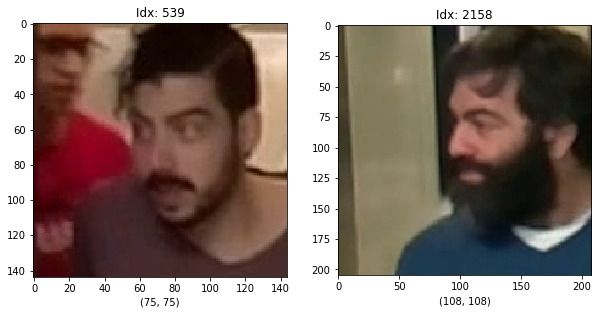

_________________________________________________________________________________________


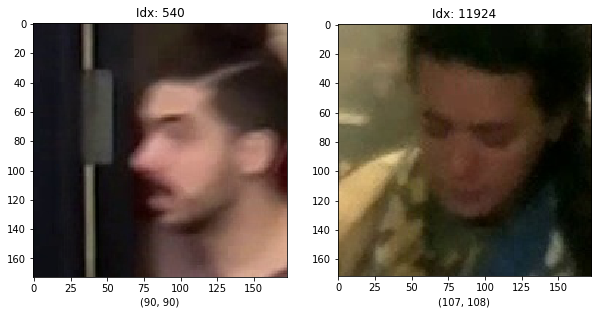

_________________________________________________________________________________________


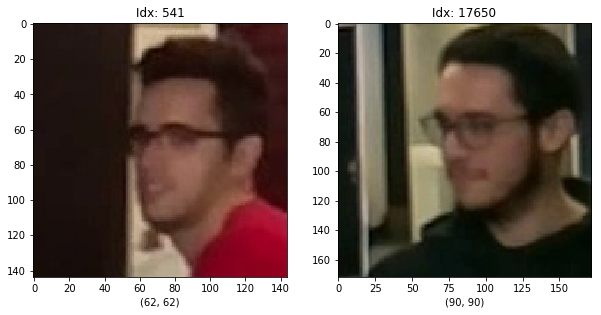

_________________________________________________________________________________________


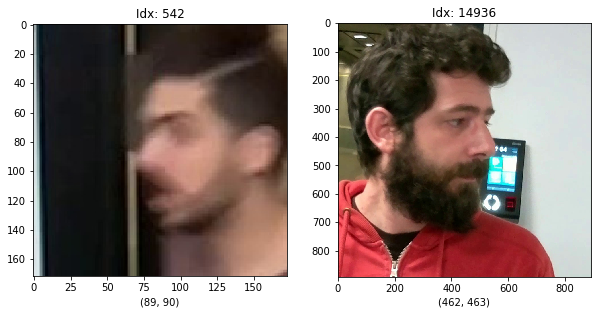

_________________________________________________________________________________________


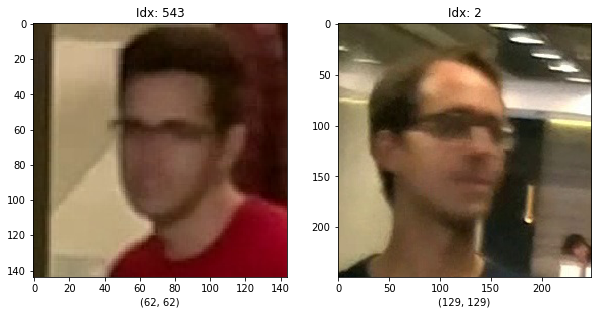

_________________________________________________________________________________________


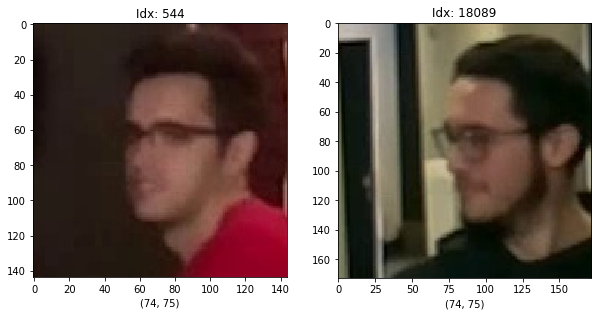

_________________________________________________________________________________________


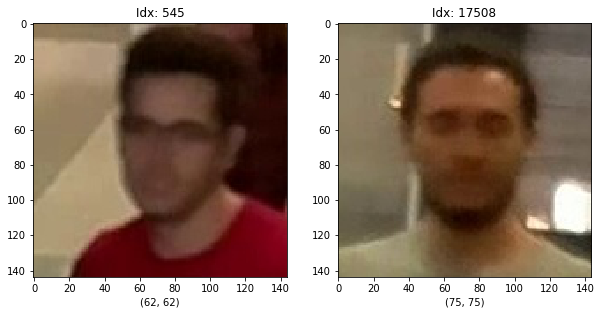

_________________________________________________________________________________________


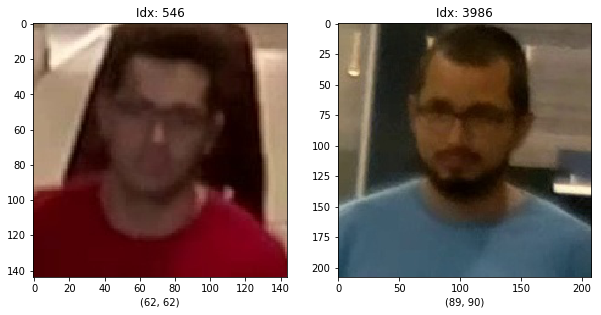

_________________________________________________________________________________________


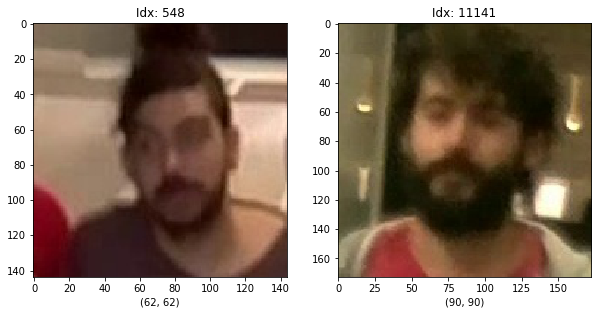

_________________________________________________________________________________________


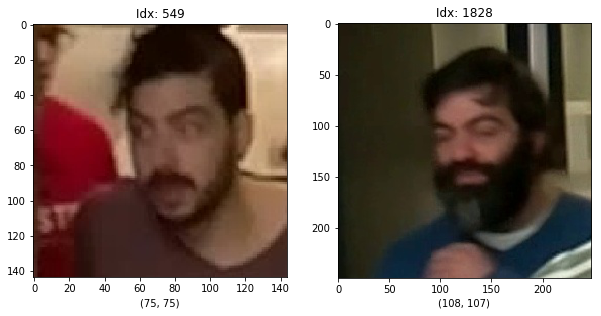

_________________________________________________________________________________________


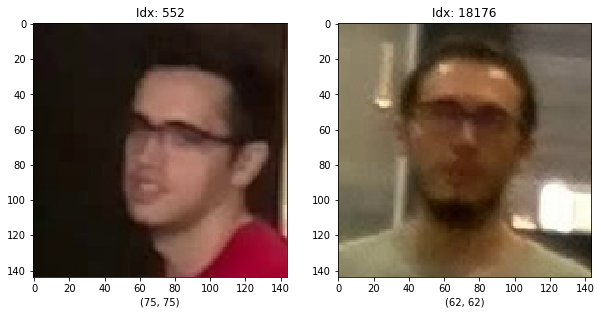

_________________________________________________________________________________________


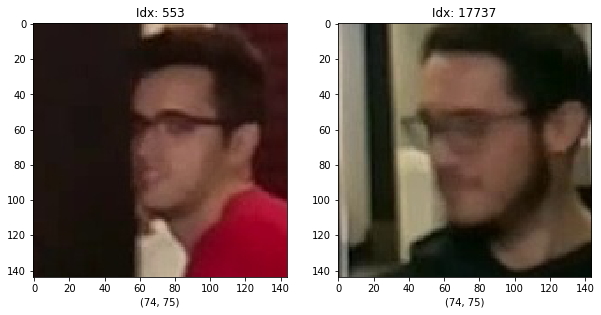

_________________________________________________________________________________________


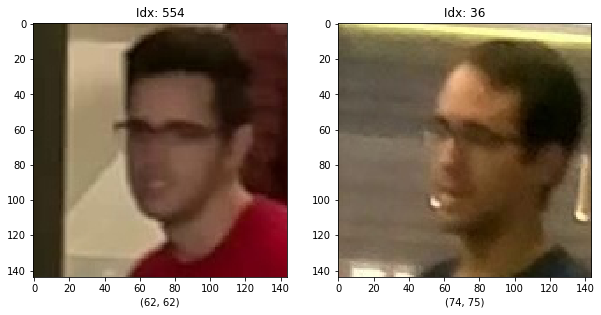

_________________________________________________________________________________________


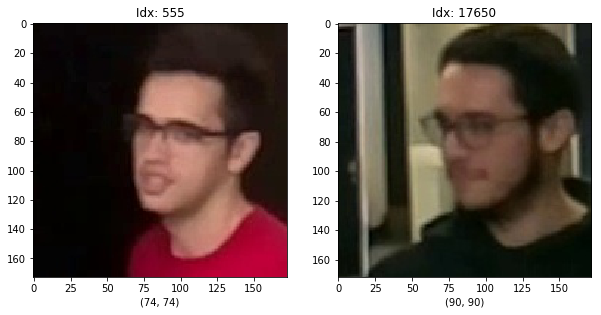

_________________________________________________________________________________________


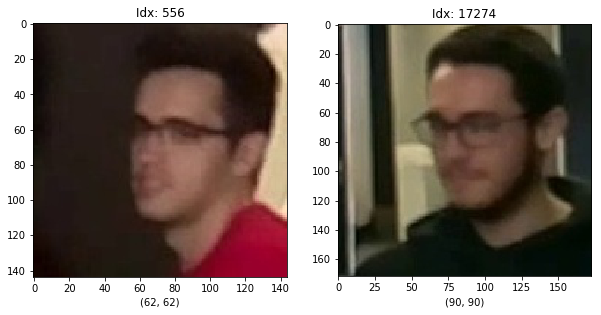

_________________________________________________________________________________________


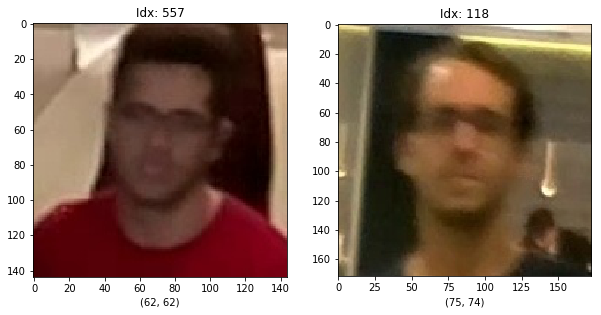

_________________________________________________________________________________________


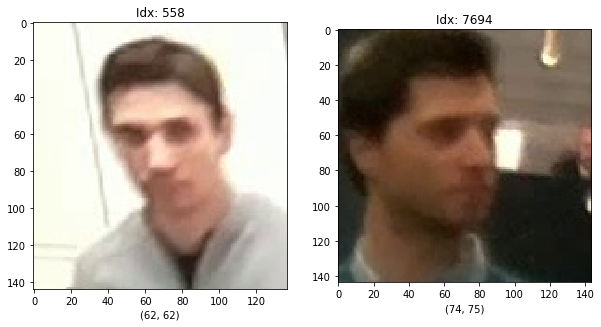

_________________________________________________________________________________________


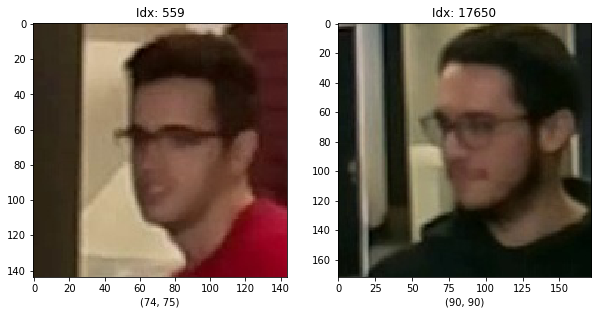

_________________________________________________________________________________________


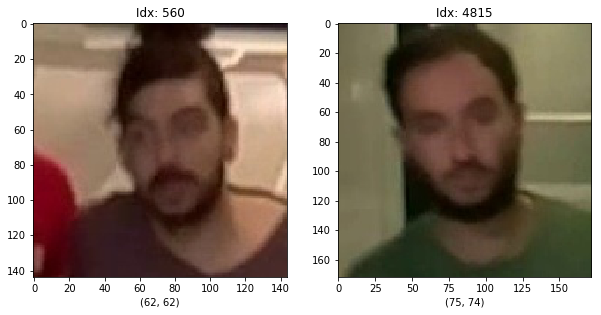

_________________________________________________________________________________________


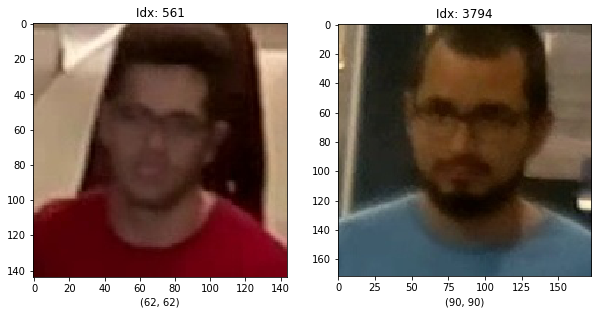

_________________________________________________________________________________________


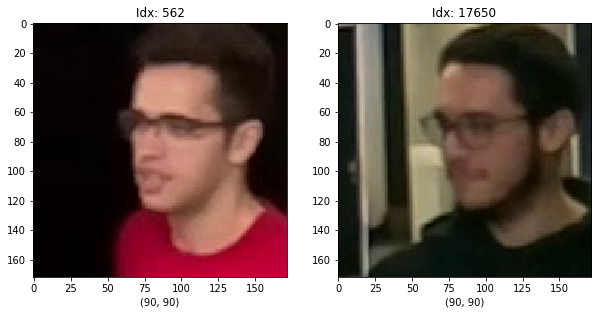

_________________________________________________________________________________________


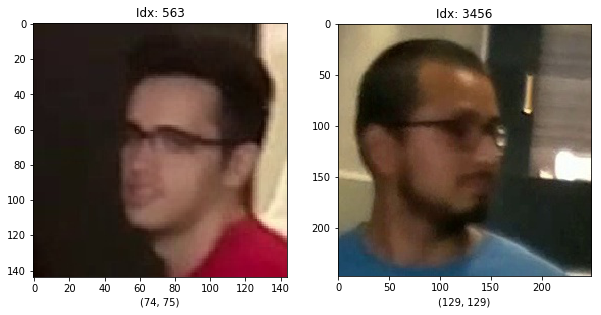

_________________________________________________________________________________________


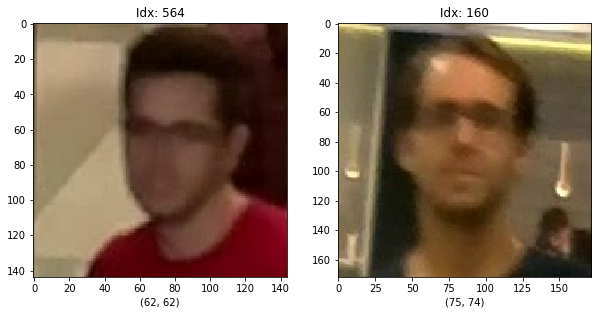

_________________________________________________________________________________________


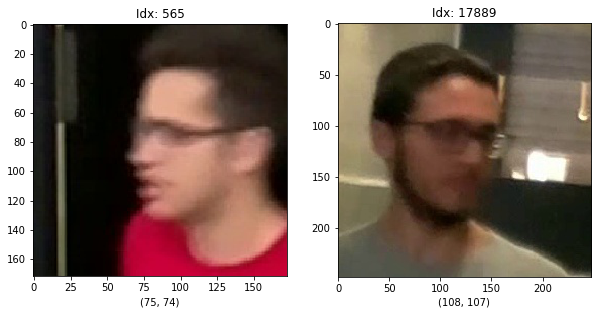

_________________________________________________________________________________________


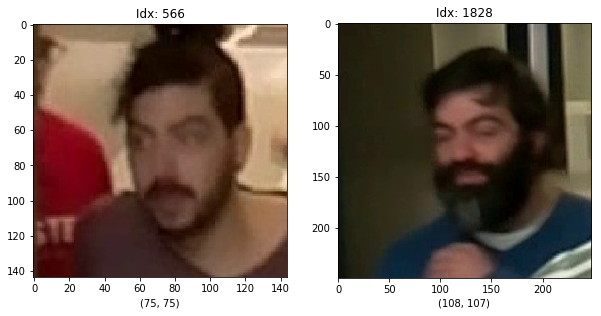

_________________________________________________________________________________________


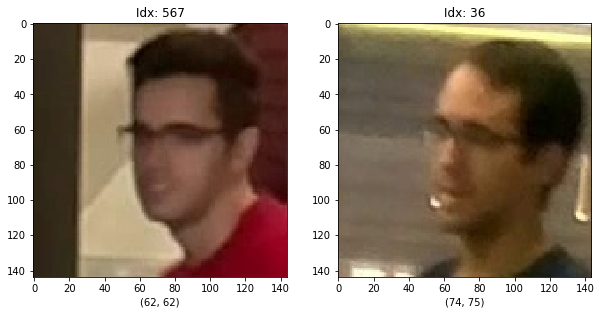

_________________________________________________________________________________________


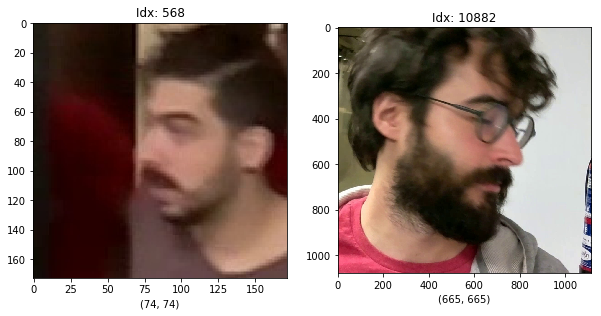

_________________________________________________________________________________________


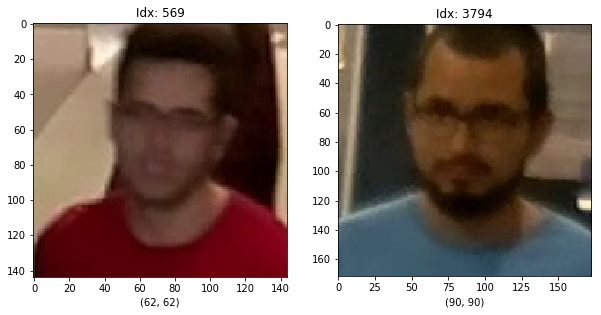

_________________________________________________________________________________________


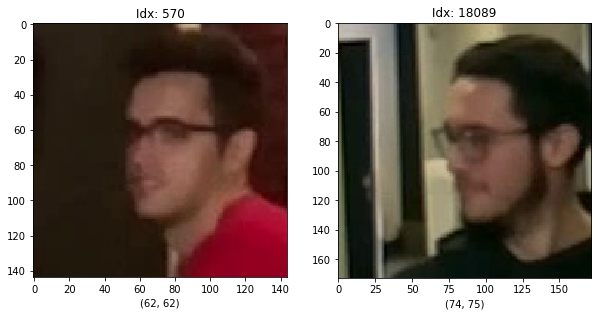

_________________________________________________________________________________________


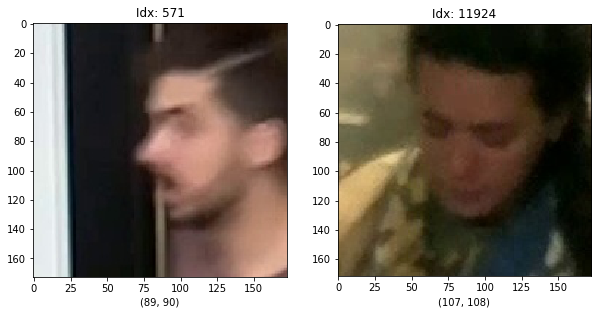

_________________________________________________________________________________________


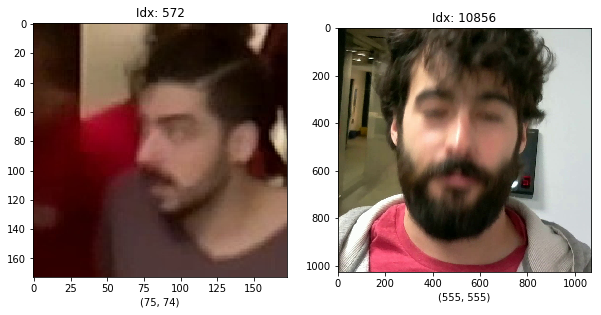

_________________________________________________________________________________________


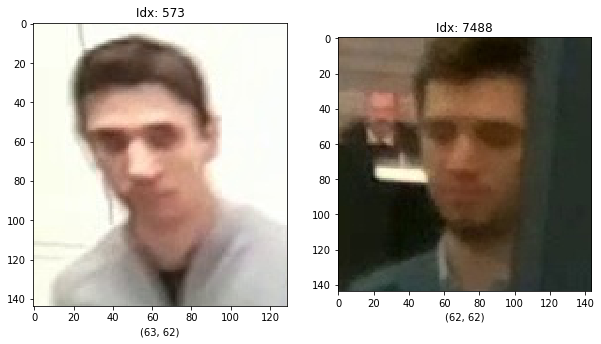

_________________________________________________________________________________________


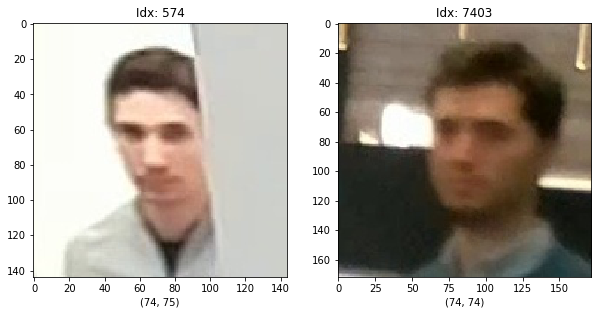

_________________________________________________________________________________________


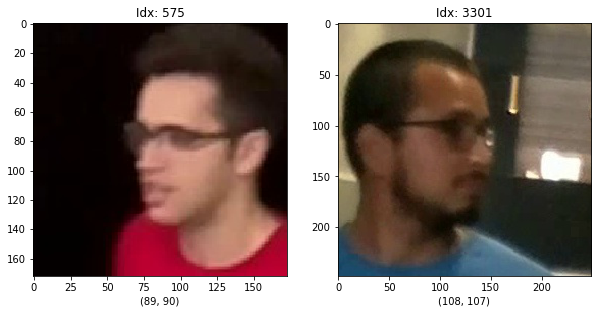

_________________________________________________________________________________________


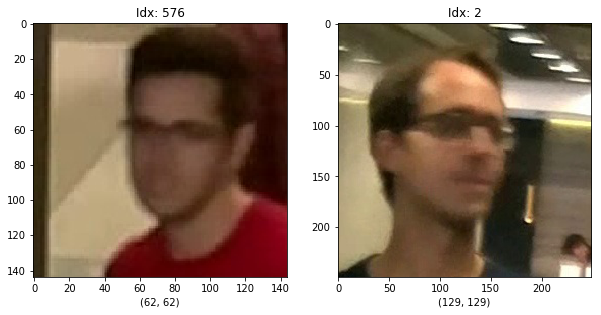

_________________________________________________________________________________________


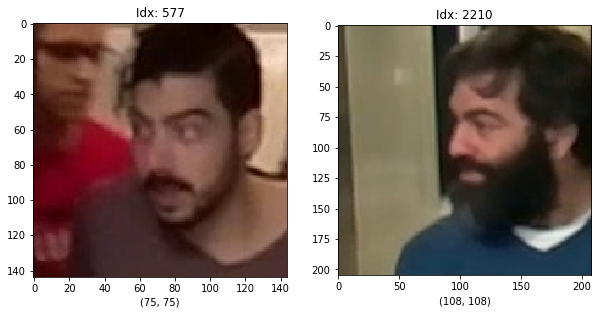

_________________________________________________________________________________________


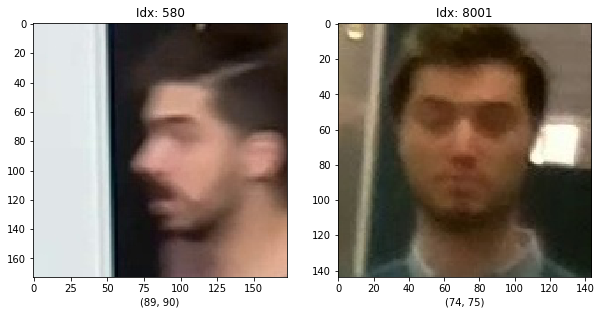

_________________________________________________________________________________________


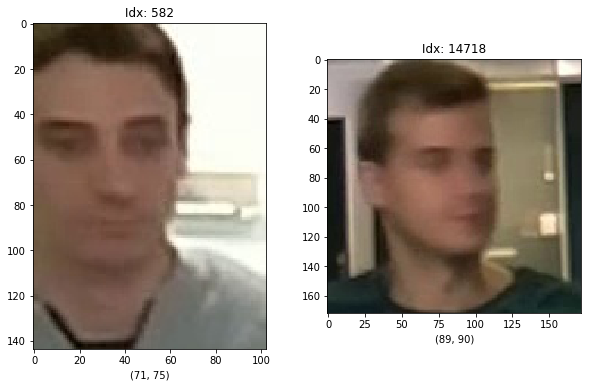

_________________________________________________________________________________________


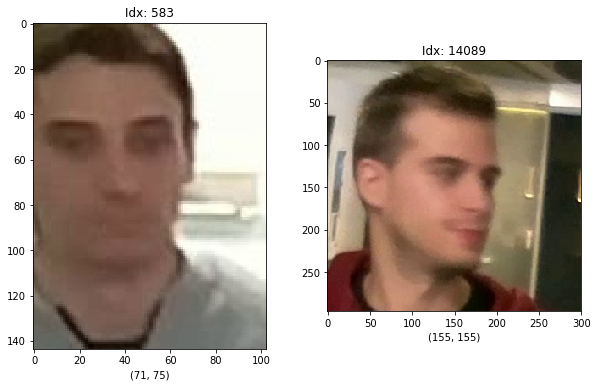

_________________________________________________________________________________________


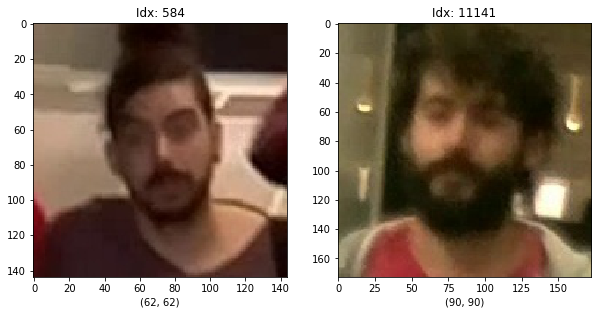

_________________________________________________________________________________________


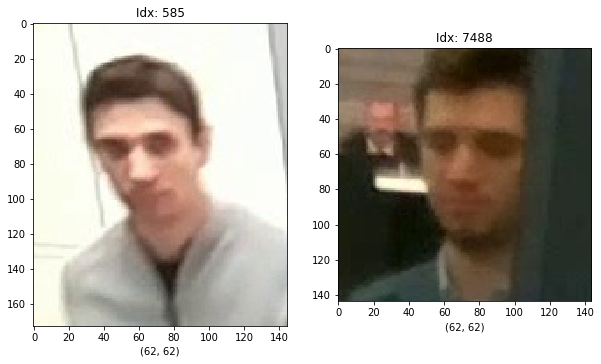

_________________________________________________________________________________________


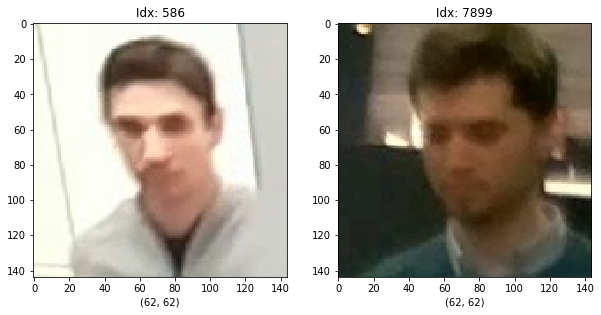

_________________________________________________________________________________________


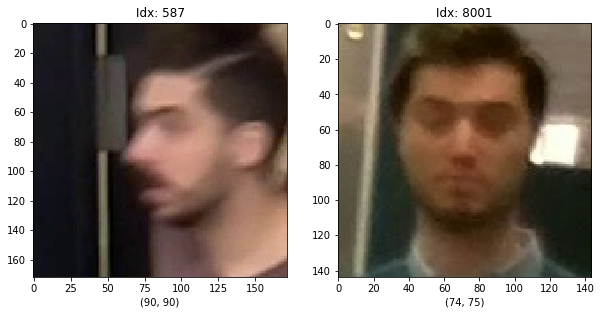

_________________________________________________________________________________________


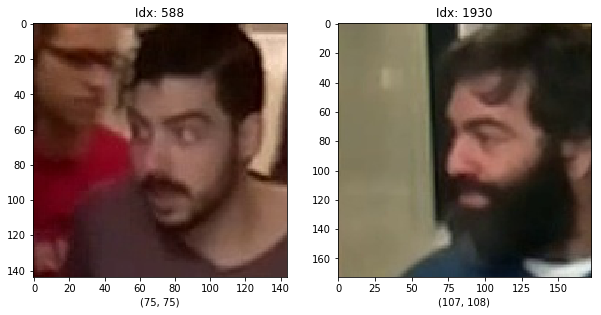

_________________________________________________________________________________________


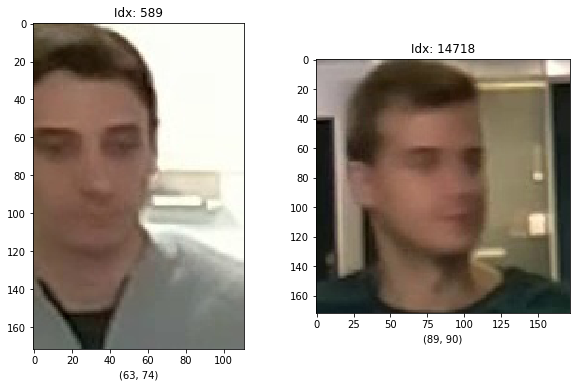

_________________________________________________________________________________________


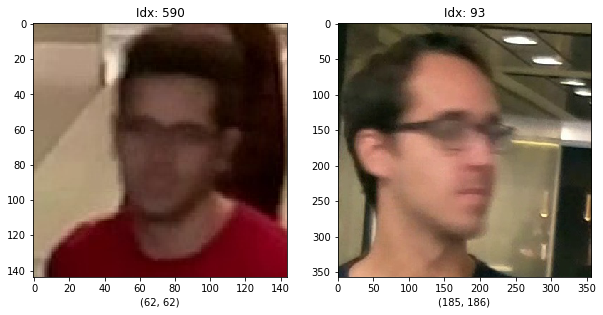

_________________________________________________________________________________________


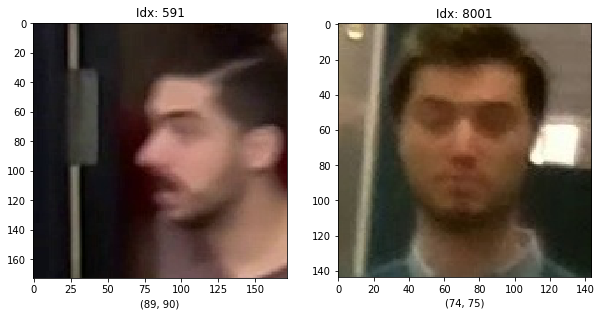

_________________________________________________________________________________________


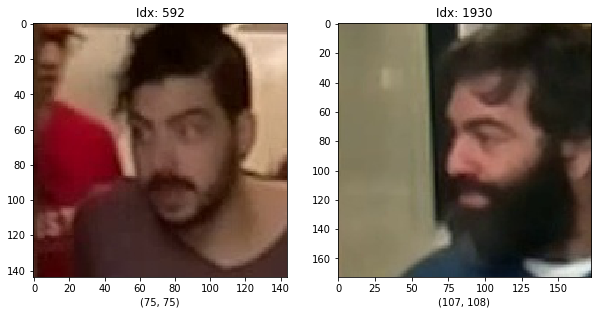

_________________________________________________________________________________________


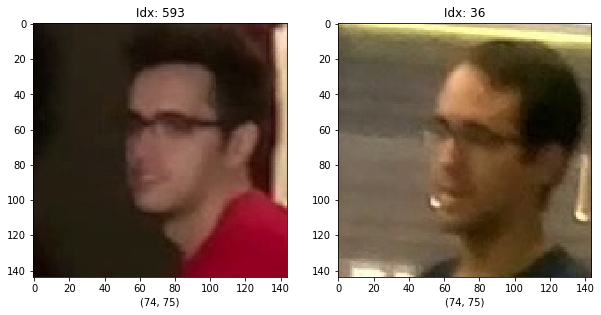

_________________________________________________________________________________________


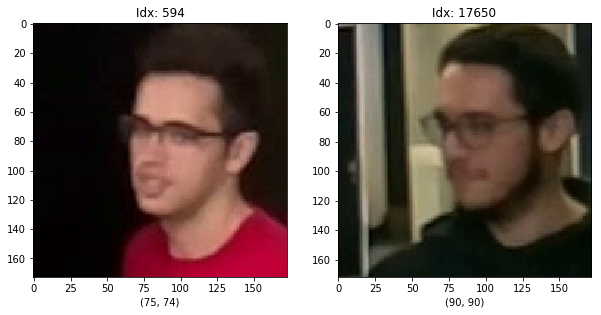

_________________________________________________________________________________________


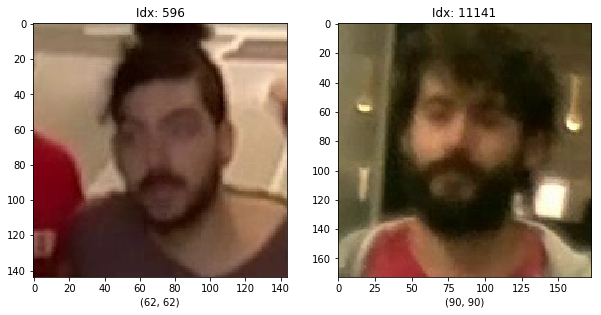

_________________________________________________________________________________________


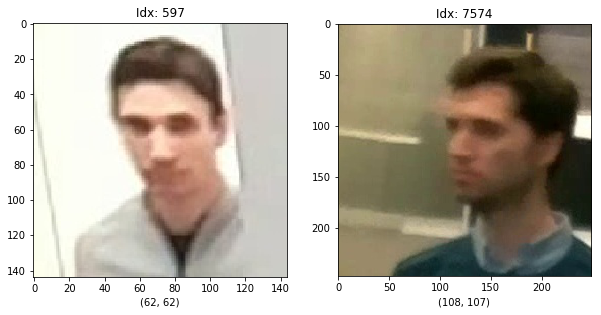

_________________________________________________________________________________________


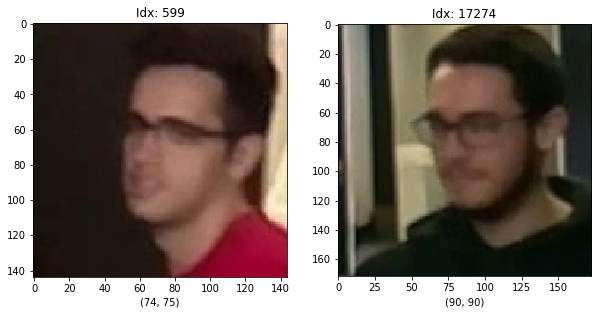

_________________________________________________________________________________________


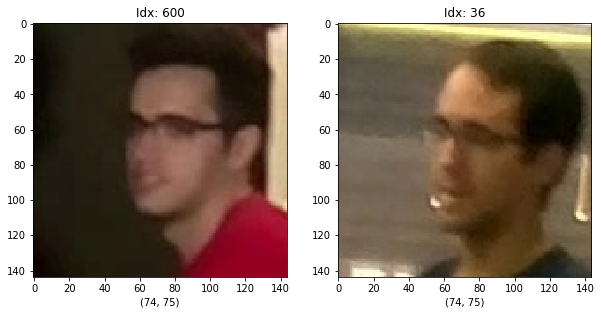

_________________________________________________________________________________________


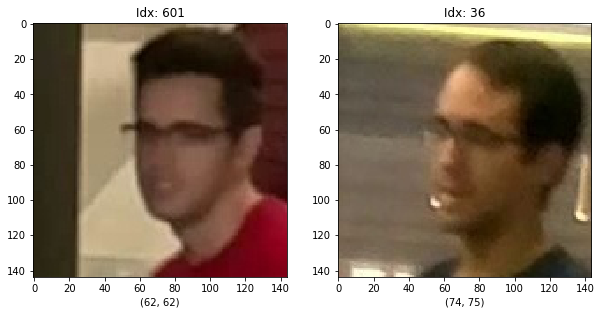

_________________________________________________________________________________________


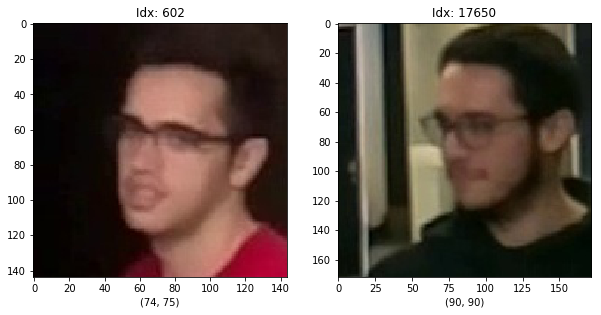

_________________________________________________________________________________________


In [18]:
draw_error_analysis(analysis_k1, train_img_paths, train_img_sizes, eval_img_paths, eval_img_sizes)

#### KNN k=3

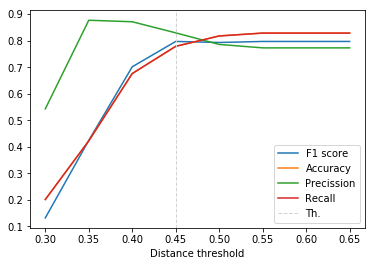

Optimal threshold: 0.45
F1-Score: [0.13170664426015424, 0.42406149821082229, 0.70150479854495562, 0.79713238859732694, 0.79316123542791372, 0.79707845807746791, 0.79707845807746791, 0.79707845807746791]
Accuracy: [0.20107962213225372, 0.4224021592442645, 0.67611336032388669, 0.77867746288798922, 0.81781376518218618, 0.82860998650472339, 0.82860998650472339, 0.82860998650472339]
Precission: [0.54282924053504344, 0.87701414845955317, 0.87126395144900148, 0.82950900812881956, 0.78579053210303995, 0.77285028507009867, 0.77285028507009867, 0.77285028507009867]
Recall: [0.20107962213225372, 0.4224021592442645, 0.67611336032388669, 0.77867746288798922, 0.81781376518218618, 0.82860998650472339, 0.82860998650472339, 0.82860998650472339]


In [19]:
opt_tau_k3, f1_k3, accuracy_k3, precission_k3, recall_k3, labeled_name_k3, predicted_name_k3, knn_output_k3 = \
    get_performance_v2(3, np.arange(0.3, 0.7, 0.05), train_face_names, train_face_embeddings, eval_face_names_unk, eval_face_embeddings, "unknown")

print("Optimal threshold: " + str(opt_tau_k3))
print("F1-Score: " + str(f1_k3))
print("Accuracy: " + str(accuracy_k3))
print("Precission: " + str(precission_k3))
print("Recall: " + str(recall_k3))

In [20]:
analysis_k3 = error_analysis(labeled_name_k3, predicted_name_k3, knn_output_k3)

Total evaluation samples: 741
Total errors: 164
Correct recognized: 550
Correct unknown: 27
Error - unrecognized (someone --> unknown): 67
Error - missclasified (someone --> other): 14
Error - false positive (unknown --> someone): 83


#### KNN  k=5

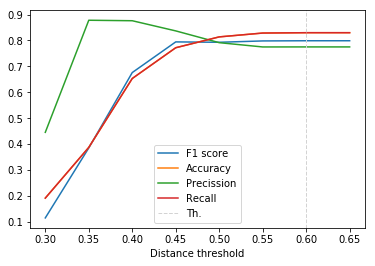

Optimal threshold: 0.6
F1-Score: [0.11516980997157503, 0.38519863223134004, 0.67611708814621652, 0.79443681751402628, 0.79301513233584353, 0.79817265915035318, 0.79887194201762868, 0.79887194201762868]
Accuracy: [0.19163292847503374, 0.38731443994601888, 0.65317139001349522, 0.77192982456140347, 0.81376518218623484, 0.82860998650472339, 0.82995951417004044, 0.82995951417004044]
Precission: [0.44543359048592512, 0.87801119138877382, 0.87611785334848158, 0.83689888546905356, 0.79146989211229757, 0.77493624084112867, 0.77506869109141074, 0.77506869109141074]
Recall: [0.19163292847503374, 0.38731443994601888, 0.65317139001349522, 0.77192982456140347, 0.81376518218623484, 0.82860998650472339, 0.82995951417004044, 0.82995951417004044]


In [21]:
opt_tau_k5, f1_k5, accuracy_k5, precission_k5, recall_k5, labeled_name_k5, predicted_name_k5, knn_output_k5 = \
    get_performance_v2(5, np.arange(0.3, 0.7, 0.05), train_face_names, train_face_embeddings, eval_face_names_unk, eval_face_embeddings, "unknown")

print("Optimal threshold: " + str(opt_tau_k5))
print("F1-Score: " + str(f1_k5))
print("Accuracy: " + str(accuracy_k5))
print("Precission: " + str(precission_k5))
print("Recall: " + str(recall_k5))

In [22]:
analysis_k5 = error_analysis(labeled_name_k5, predicted_name_k5, knn_output_k5)

Total evaluation samples: 741
Total errors: 126
Correct recognized: 615
Correct unknown: 0
Error - unrecognized (someone --> unknown): 0
Error - missclasified (someone --> other): 16
Error - false positive (unknown --> someone): 110


## Error - size distribution

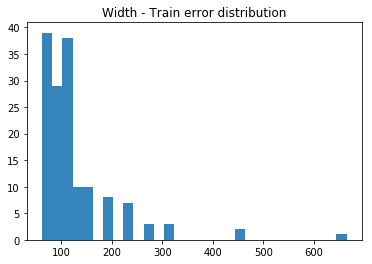

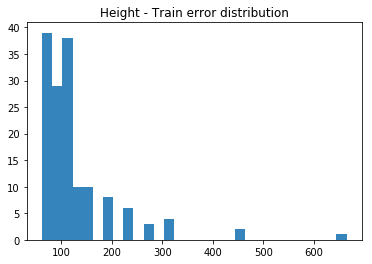

In [27]:
train_errors = []
train_errors.extend(analysis_k3["unrecognized_errors"])
train_errors.extend(analysis_k3["false_positive_errors"])
train_sizes = [ train_img_sizes[knn["indices"][0]] for _, knn in train_errors ]

train_w_e, train_h_e = zip(*train_sizes)

plt.hist(train_w_e, 30, alpha=0.9, density=False)
plt.title("Width - Train error distribution")
plt.show()

plt.hist(train_h_e, 30, alpha=0.9, density=False)
plt.title("Height - Train error distribution")
plt.show()

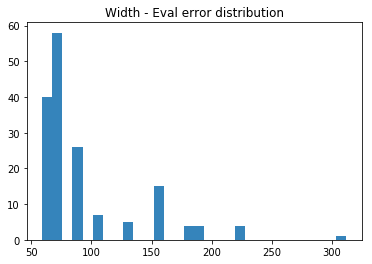

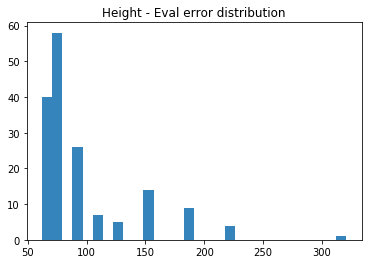

In [29]:
eval_errors = []
eval_errors.extend(analysis_k3["unrecognized_errors"])
eval_errors.extend(analysis_k3["misclassified_errors"])
eval_errors.extend(analysis_k3["false_positive_errors"])

eval_sizes = [ eval_img_sizes[idx] for idx, _ in eval_errors ]

eval_w_e, eval_h_e = zip(*eval_sizes)

plt.hist(eval_w_e, 30, alpha=0.9, density=False)
plt.title("Width - Eval error distribution")
plt.show()

plt.hist(eval_h_e, 30, alpha=0.9, density=False)
plt.title("Height - Eval error distribution")
plt.show()

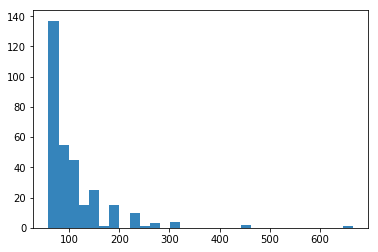

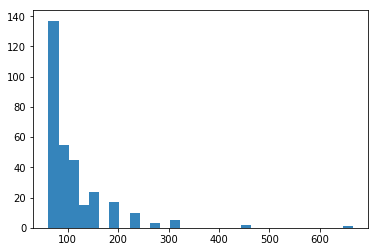

In [30]:
error_sizes = eval_sizes
error_sizes.extend(train_sizes)
w_e, h_e = zip(*error_sizes)

plt.hist(w_e, 30, alpha=0.9, density=False, label="Width - error distribution")
plt.show()

plt.hist(h_e, 30, alpha=0.9, density=False, label="Height - error distribution")
plt.show()

## Conclusion

* Small faces (~ < 100 px) are poor recognized, introducing a lot of errors

## Remove small faces

In [31]:
min_size = 100

In [32]:
idx_train_small = [i for i, (w,h) in enumerate(train_img_sizes) if w > min_size]

nosmall_train_face_names = np.array(train_face_names)[idx_train_small].tolist()
nosmall_train_face_embeddings = [e for i, e in enumerate(train_face_embeddings) if i in idx_train_small]
nosmall_train_img_paths = np.array(train_img_paths)[idx_train_small].tolist()
nosmall_train_img_sizes = np.array(train_img_sizes)[idx_train_small].tolist()

In [33]:
len(nosmall_train_face_names)

13729

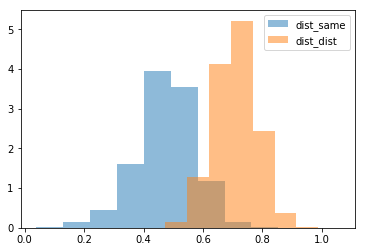

In [44]:
show_distances_distributions(nosmall_train_face_names, nosmall_train_face_embeddings)

In [34]:
new_face_db = {}
new_face_db['names'] = nosmall_train_face_names
new_face_db['embedding'] = nosmall_train_face_embeddings
new_face_db['images_path'] = nosmall_train_img_paths
new_face_db['sizes'] = nosmall_train_img_sizes

In [35]:
with open(str("spaceai-evolution-train-v3-no-small.db"), 'wb') as fp:
    pickle.dump(new_face_db, fp)

In [36]:
idx_eval_small = [i for i, (w,h) in enumerate(eval_img_sizes) if w > min_size]

nosmall_eval_face_names = np.array(eval_face_names)[idx_eval_small].tolist()
nosmall_eval_face_names_unk = np.array(eval_face_names_unk)[idx_eval_small].tolist()
nosmall_eval_face_embeddings = [e for i, e in enumerate(eval_face_embeddings) if i in idx_eval_small]
nosmall_eval_img_paths = np.array(eval_img_paths)[idx_eval_small].tolist()
nosmall_eval_img_sizes = np.array(eval_img_sizes)[idx_eval_small].tolist()

### Analysis without small faces

#### Min. distance search (KNN k=1)

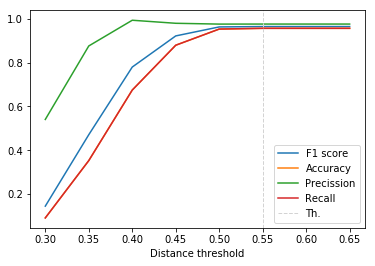

Optimal threshold: 0.55
F1-Score: [0.14431815383285826, 0.47056616713447691, 0.77953334732695911, 0.92171996498199549, 0.96275999460714723, 0.96446077413109554, 0.96446077413109554, 0.96446077413109554]
Accuracy: [0.090604026845637578, 0.3523489932885906, 0.67449664429530198, 0.87919463087248317, 0.95302013422818788, 0.9563758389261745, 0.9563758389261745, 0.9563758389261745]
Precission: [0.54026845637583898, 0.87583892617449666, 0.99328859060402686, 0.97940977012838204, 0.97568730629445466, 0.97586840781783812, 0.97586840781783812, 0.97586840781783812]
Recall: [0.090604026845637578, 0.3523489932885906, 0.67449664429530198, 0.87919463087248317, 0.95302013422818788, 0.9563758389261745, 0.9563758389261745, 0.9563758389261745]


In [37]:
opt_tau_k1, f1_k1, accuracy_k1, precission_k1, recall_k1, labeled_name_k1, predicted_name_k1, knn_output_k1 = \
    get_performance_v2(1, np.arange(0.3, 0.7, 0.05), nosmall_train_face_names, nosmall_train_face_embeddings, nosmall_eval_face_names_unk, nosmall_eval_face_embeddings, "unknown")

print("Optimal threshold: " + str(opt_tau_k1))
print("F1-Score: " + str(f1_k1))
print("Accuracy: " + str(accuracy_k1))
print("Precission: " + str(precission_k1))
print("Recall: " + str(recall_k1))

In [38]:
analysis_k1 = error_analysis(labeled_name_k1, predicted_name_k1, knn_output_k1)

Total evaluation samples: 298
Total errors: 13
Correct recognized: 285
Correct unknown: 0
Error - unrecognized (someone --> unknown): 0
Error - missclasified (someone --> other): 13
Error - false positive (unknown --> someone): 0


-----------------------------------------------------------
 => Unrecognized errors
-----------------------------------------------------------
-----------------------------------------------------------
 => Misclassified errors
-----------------------------------------------------------


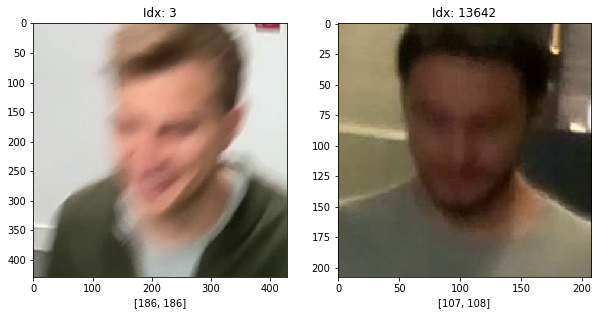

_________________________________________________________________________________________


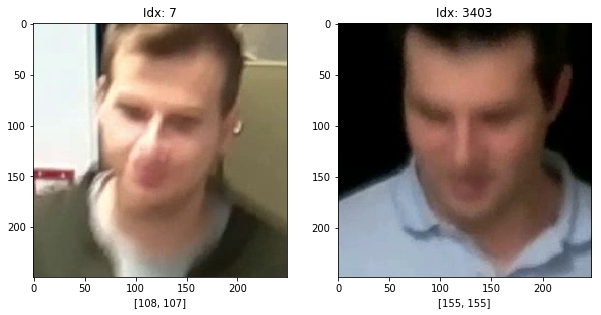

_________________________________________________________________________________________


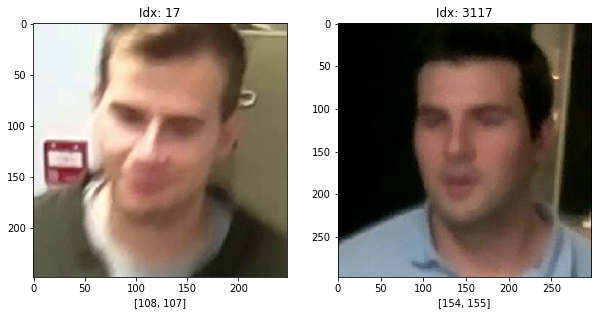

_________________________________________________________________________________________


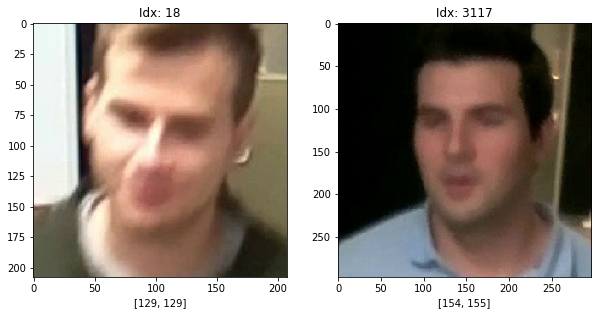

_________________________________________________________________________________________


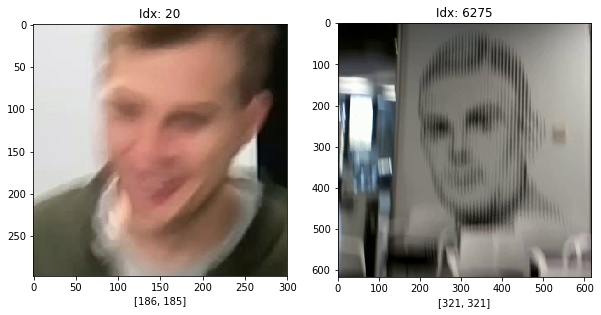

_________________________________________________________________________________________


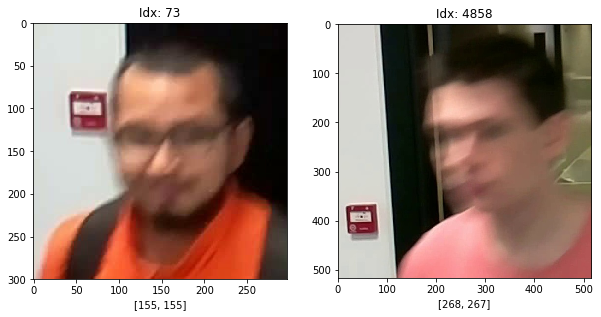

_________________________________________________________________________________________


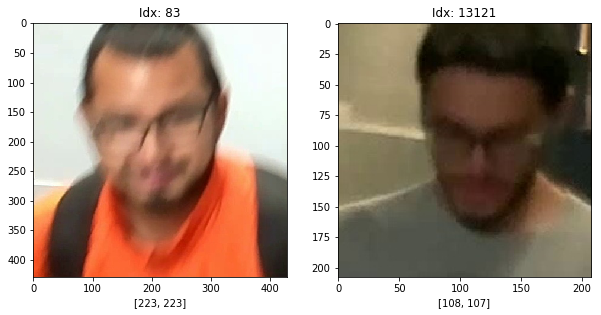

_________________________________________________________________________________________


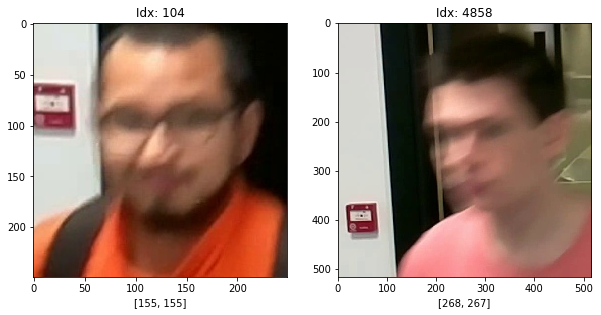

_________________________________________________________________________________________


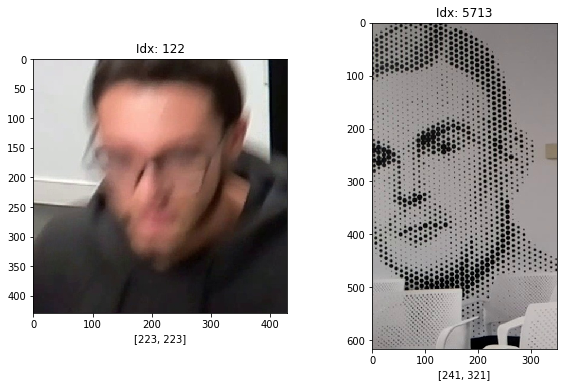

_________________________________________________________________________________________


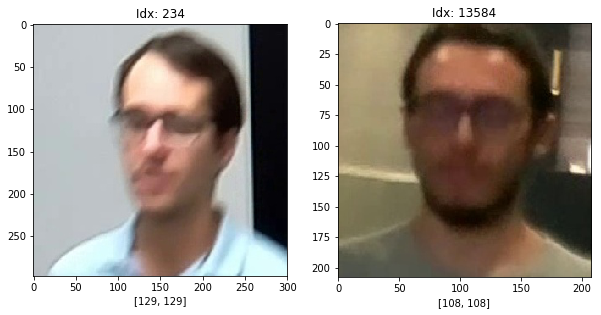

_________________________________________________________________________________________


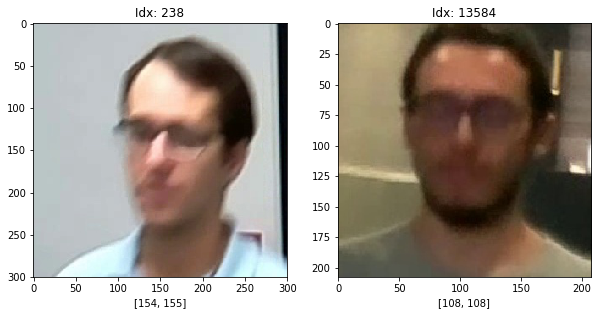

_________________________________________________________________________________________


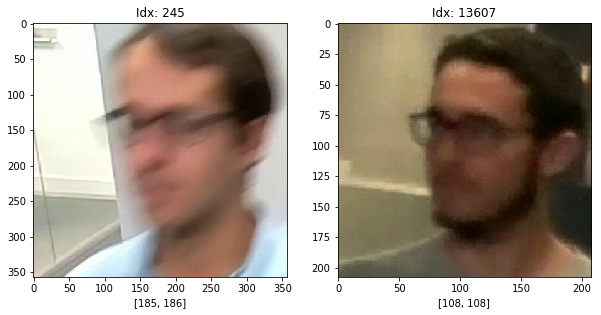

_________________________________________________________________________________________


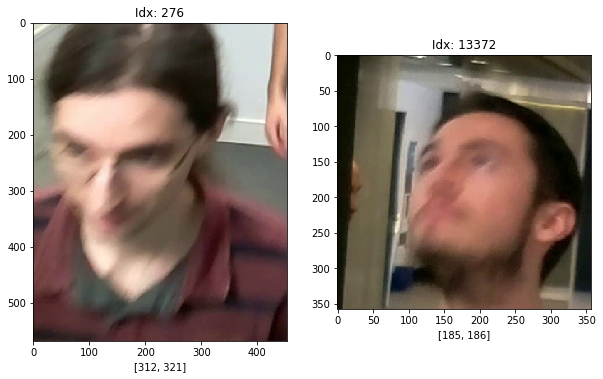

_________________________________________________________________________________________
-----------------------------------------------------------
 => False positive errors
-----------------------------------------------------------


In [39]:
draw_error_analysis(analysis_k1, nosmall_train_img_paths, nosmall_train_img_sizes, nosmall_eval_img_paths, nosmall_eval_img_sizes)

#### KNN k=3

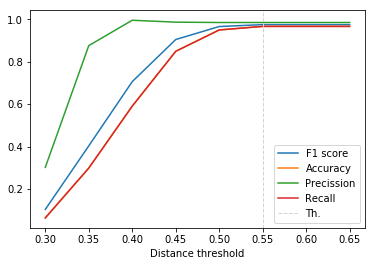

Optimal threshold: 0.55
F1-Score: [0.10368394417091156, 0.40330598751631164, 0.7061514476607107, 0.90456208943455652, 0.96584474582360758, 0.97469243670121553, 0.97469243670121553, 0.97469243670121553]
Accuracy: [0.063758389261744972, 0.29865771812080538, 0.59060402684563762, 0.84899328859060408, 0.94966442953020136, 0.96644295302013428, 0.96644295302013428, 0.96644295302013428]
Precission: [0.30201342281879195, 0.87583892617449666, 0.99544582933844672, 0.98644295302013441, 0.98481943112815595, 0.98481943112815595, 0.98481943112815595, 0.98481943112815595]
Recall: [0.063758389261744972, 0.29865771812080538, 0.59060402684563762, 0.84899328859060408, 0.94966442953020136, 0.96644295302013428, 0.96644295302013428, 0.96644295302013428]


In [40]:
opt_tau_k3, f1_k3, accuracy_k3, precission_k3, recall_k3, labeled_name_k3, predicted_name_k3, knn_output_k3 = \
    get_performance_v2(3, np.arange(0.3, 0.7, 0.05), nosmall_train_face_names, nosmall_train_face_embeddings, nosmall_eval_face_names_unk, nosmall_eval_face_embeddings, "unknown")

print("Optimal threshold: " + str(opt_tau_k3))
print("F1-Score: " + str(f1_k3))
print("Accuracy: " + str(accuracy_k3))
print("Precission: " + str(precission_k3))
print("Recall: " + str(recall_k3))

In [41]:
analysis_k3 = error_analysis(labeled_name_k3, predicted_name_k3, knn_output_k3)

Total evaluation samples: 298
Total errors: 10
Correct recognized: 288
Correct unknown: 0
Error - unrecognized (someone --> unknown): 0
Error - missclasified (someone --> other): 10
Error - false positive (unknown --> someone): 0


-----------------------------------------------------------
 => Unrecognized errors
-----------------------------------------------------------
-----------------------------------------------------------
 => Misclassified errors
-----------------------------------------------------------


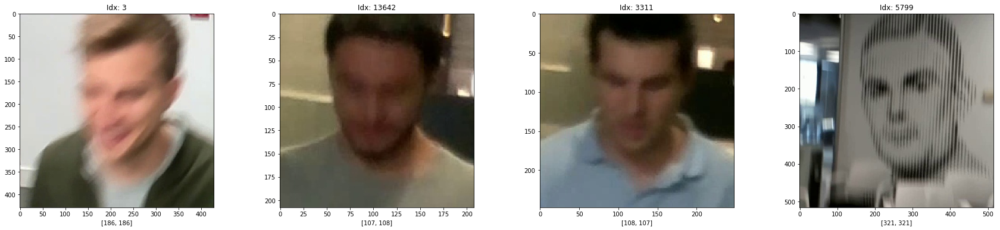

_________________________________________________________________________________________


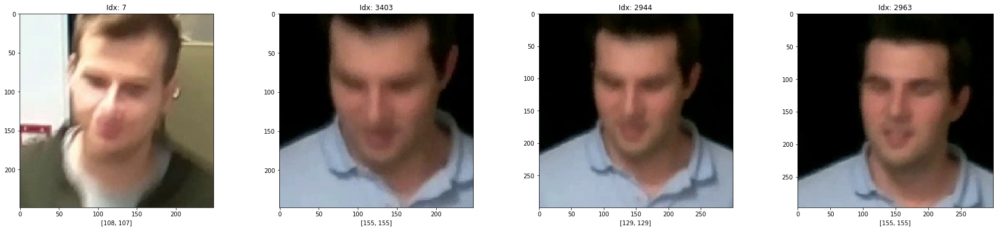

_________________________________________________________________________________________


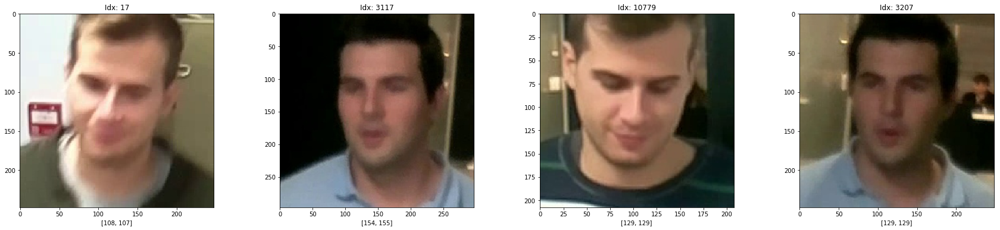

_________________________________________________________________________________________


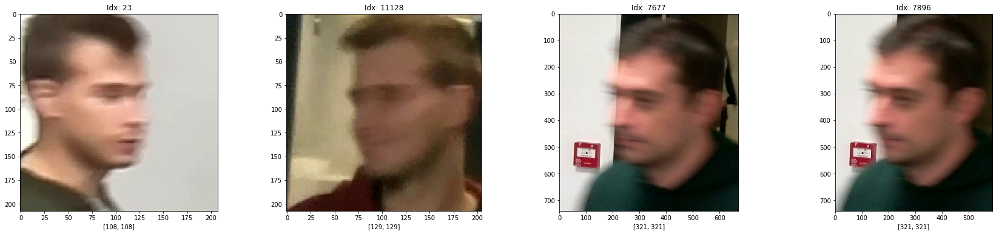

_________________________________________________________________________________________


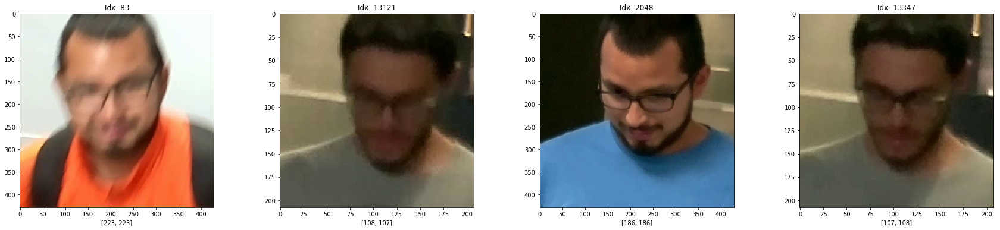

_________________________________________________________________________________________


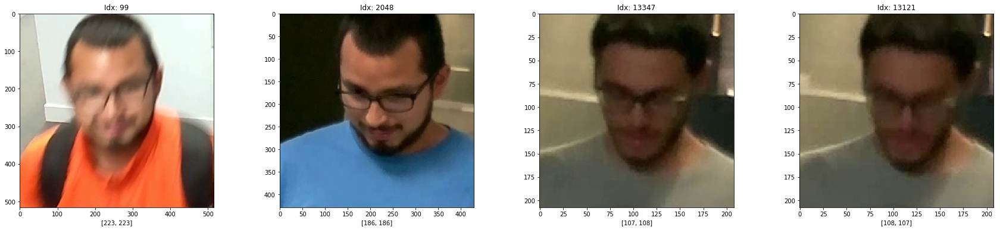

_________________________________________________________________________________________


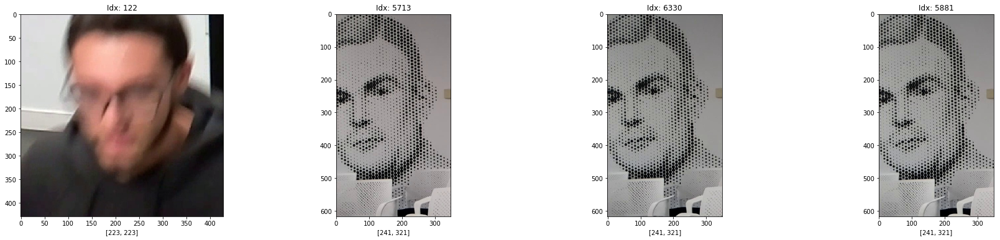

_________________________________________________________________________________________


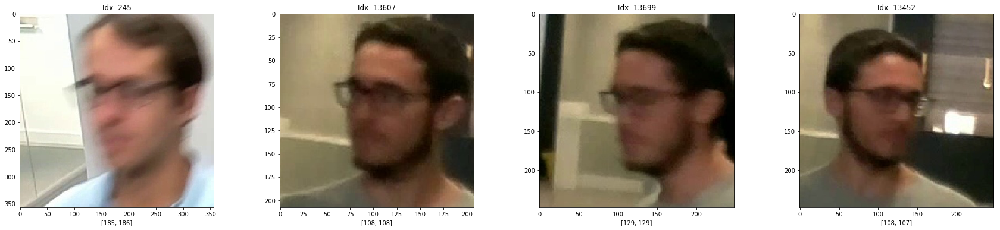

_________________________________________________________________________________________


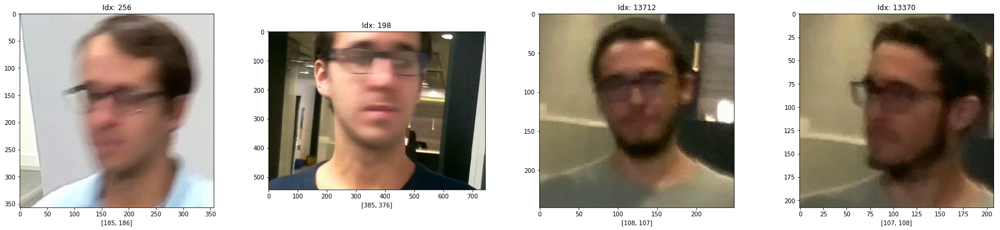

_________________________________________________________________________________________


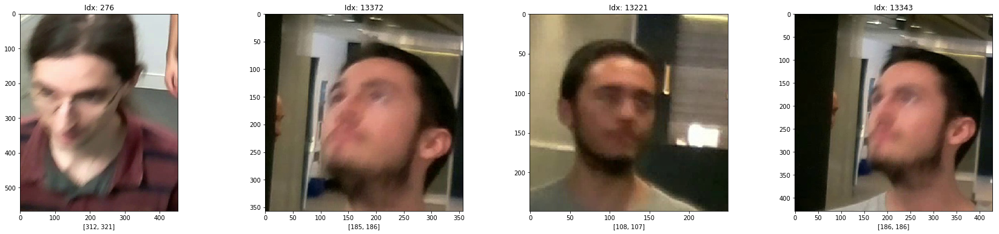

_________________________________________________________________________________________
-----------------------------------------------------------
 => False positive errors
-----------------------------------------------------------


In [42]:
draw_error_analysis(analysis_k3, nosmall_train_img_paths, nosmall_train_img_sizes, nosmall_eval_img_paths, nosmall_eval_img_sizes)

#### KNN k=5

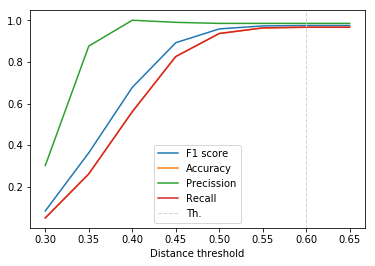

Optimal threshold: 0.6
F1-Score: [0.084097233589785561, 0.36313841868595081, 0.67730791549466451, 0.89193308109233649, 0.95829662101332036, 0.97266573814192114, 0.97460711758301632, 0.97460711758301632]
Accuracy: [0.050335570469798654, 0.26174496644295303, 0.56040268456375841, 0.82550335570469802, 0.93624161073825507, 0.96308724832214765, 0.96644295302013428, 0.96644295302013428]
Precission: [0.30201342281879195, 0.87583892617449666, 1.0, 0.98993288590604023, 0.98481943112815595, 0.98481943112815595, 0.98481943112815595, 0.98481943112815595]
Recall: [0.050335570469798654, 0.26174496644295303, 0.56040268456375841, 0.82550335570469802, 0.93624161073825507, 0.96308724832214765, 0.96644295302013428, 0.96644295302013428]
Total evaluation samples: 298
Total errors: 10
Correct recognized: 288
Correct unknown: 0
Error - unrecognized (someone --> unknown): 0
Error - missclasified (someone --> other): 10
Error - false positive (unknown --> someone): 0
--------------------------------------------

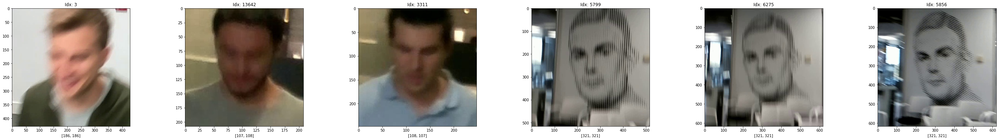

_________________________________________________________________________________________


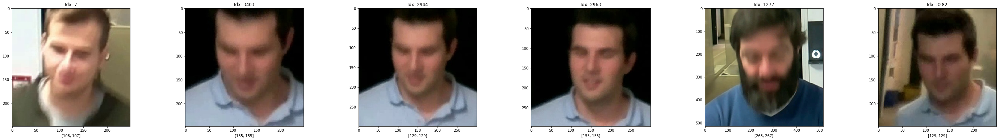

_________________________________________________________________________________________


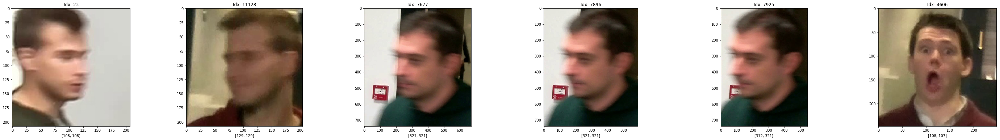

_________________________________________________________________________________________


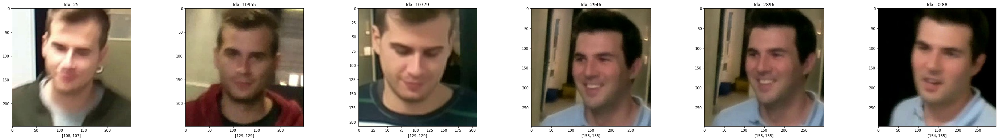

_________________________________________________________________________________________


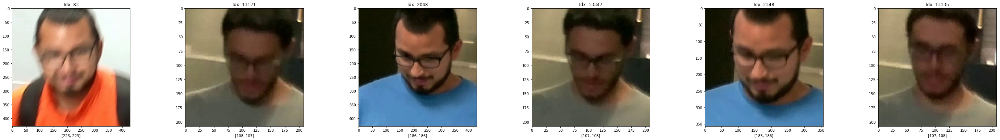

_________________________________________________________________________________________


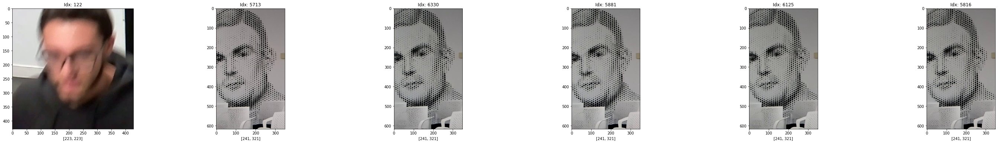

_________________________________________________________________________________________


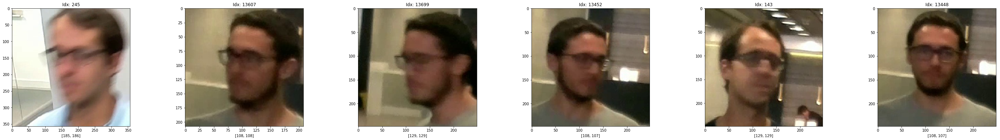

_________________________________________________________________________________________


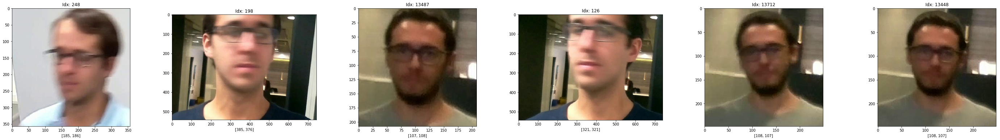

_________________________________________________________________________________________


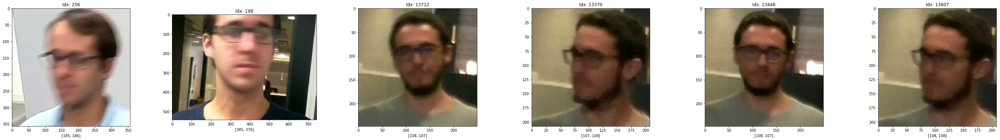

_________________________________________________________________________________________


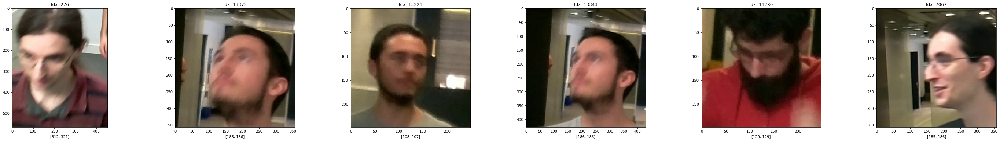

_________________________________________________________________________________________
-----------------------------------------------------------
 => False positive errors
-----------------------------------------------------------


In [43]:
opt_tau_k5, f1_k5, accuracy_k5, precission_k5, recall_k5, labeled_name_k5, predicted_name_k5, knn_output_k5 = \
    get_performance_v2(5, np.arange(0.3, 0.7, 0.05), nosmall_train_face_names, nosmall_train_face_embeddings, nosmall_eval_face_names_unk, nosmall_eval_face_embeddings, "unknown")

print("Optimal threshold: " + str(opt_tau_k5))
print("F1-Score: " + str(f1_k5))
print("Accuracy: " + str(accuracy_k5))
print("Precission: " + str(precission_k5))
print("Recall: " + str(recall_k5))

analysis_k5 = error_analysis(labeled_name_k5, predicted_name_k5, knn_output_k5)
draw_error_analysis(analysis_k5, nosmall_train_img_paths, nosmall_train_img_sizes, nosmall_eval_img_paths, nosmall_eval_img_sizes)